In [1]:
import os
import random
from sklearn.model_selection import train_test_split
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image

import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import matplotlib.pyplot as plt
from sklearn.metrics import jaccard_score
from torchvision import transforms
import numpy as np

# Set random seed for reproducibility
def seed_everything(seed=42):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

seed_everything()

class SegmentationDataset(Dataset):
    def __init__(self, image_paths, mask_paths, transform=None):
        self.image_paths = image_paths
        self.mask_paths = mask_paths
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        mask_path = self.mask_paths[idx]

        image = Image.open(img_path).convert("RGB")
        mask = Image.open(mask_path).convert("L")

        if self.transform:
            image = self.transform(image)
            mask = transforms.Resize((256, 256))(mask)
            mask = transforms.ToTensor()(mask)

        return image, mask

# Define transformations
train_transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.RandomRotation(degrees=15),
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),
    transforms.RandomAffine(degrees=0, translate=(0.1, 0.1)),
    transforms.RandomPerspective(distortion_scale=0.2, p=0.5),
    transforms.ToTensor(),
])

val_test_transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
])

# Load dataset paths
image_dir = "/kaggle/input/kvasir-seg/Kvasir-SEG/images"
mask_dir = "/kaggle/input/kvasir-seg/Kvasir-SEG/masks"

images = sorted(os.listdir(image_dir))
masks = sorted(os.listdir(mask_dir))

image_paths = [os.path.join(image_dir, img) for img in images]
mask_paths = [os.path.join(mask_dir, mask) for mask in masks]

# Split into train (85%), validation (10%), and test (5%)
train_imgs, temp_imgs, train_masks, temp_masks = train_test_split(image_paths, mask_paths, test_size=0.15, random_state=42)
val_imgs, test_imgs, val_masks, test_masks = train_test_split(temp_imgs, temp_masks, test_size=0.3333, random_state=42)

# Initialize datasets
train_dataset = SegmentationDataset(train_imgs, train_masks, transform=train_transform)
val_dataset = SegmentationDataset(val_imgs, val_masks, transform=val_test_transform)
test_dataset = SegmentationDataset(test_imgs, test_masks, transform=val_test_transform)

# Create DataLoaders
train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=8, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=8, shuffle=False)


In [2]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class ConvBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(ConvBlock, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
        )

    def forward(self, x):
        return self.conv(x)

class AttentionBlock(nn.Module):
    def __init__(self, f_g, f_l, f_int):
        super(AttentionBlock, self).__init__()
        self.W_g = nn.Sequential(
            nn.Conv2d(f_g, f_int, kernel_size=1, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(f_int)
        )

        self.W_x = nn.Sequential(
            nn.Conv2d(f_l, f_int, kernel_size=1, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(f_int)
        )

        self.psi = nn.Sequential(
            nn.Conv2d(f_int, 1, kernel_size=1, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(1),
            nn.Sigmoid()
        )

        self.relu = nn.ReLU(inplace=True)

    def forward(self, g, x):
        g1 = self.W_g(g)
        x1 = self.W_x(x)
        psi = self.relu(g1 + x1)
        psi = self.psi(psi)
        return x * psi

class AttentionUNet(nn.Module):
    def __init__(self, in_channels=1, out_channels=1):
        super(AttentionUNet, self).__init__()

        self.encoder1 = ConvBlock(in_channels, 64)
        self.encoder2 = ConvBlock(64, 128)
        self.encoder3 = ConvBlock(128, 256)
        self.encoder4 = ConvBlock(256, 512)
        self.center = ConvBlock(512, 1024)

        self.att4 = AttentionBlock(512, 512, 256)
        self.upconv4 = nn.ConvTranspose2d(1024, 512, kernel_size=2, stride=2)
        self.decoder4 = ConvBlock(1024, 512)

        self.att3 = AttentionBlock(256, 256, 128)
        self.upconv3 = nn.ConvTranspose2d(512, 256, kernel_size=2, stride=2)
        self.decoder3 = ConvBlock(512, 256)

        self.att2 = AttentionBlock(128, 128, 64)
        self.upconv2 = nn.ConvTranspose2d(256, 128, kernel_size=2, stride=2)
        self.decoder2 = ConvBlock(256, 128)

        self.att1 = AttentionBlock(64, 64, 32)
        self.upconv1 = nn.ConvTranspose2d(128, 64, kernel_size=2, stride=2)
        self.decoder1 = ConvBlock(128, 64)

        self.final_conv = nn.Conv2d(64, out_channels, kernel_size=1)

        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)

    def forward(self, x):
        e1 = self.encoder1(x)
        e2 = self.encoder2(self.pool(e1))
        e3 = self.encoder3(self.pool(e2))
        e4 = self.encoder4(self.pool(e3))

        center = self.center(self.pool(e4))

        d4 = self.upconv4(center)
        e4 = self.att4(d4, e4)
        d4 = self.decoder4(torch.cat((d4, e4), dim=1))

        d3 = self.upconv3(d4)
        e3 = self.att3(d3, e3)
        d3 = self.decoder3(torch.cat((d3, e3), dim=1))

        d2 = self.upconv2(d3)
        e2 = self.att2(d2, e2)
        d2 = self.decoder2(torch.cat((d2, e2), dim=1))

        d1 = self.upconv1(d2)
        e1 = self.att1(d1, e1)
        d1 = self.decoder1(torch.cat((d1, e1), dim=1))

        output = self.final_conv(d1)
        return output

# Example usage
if __name__ == "__main__":
    model = AttentionUNet(in_channels=1, out_channels=1)
    x = torch.randn(1, 1, 256, 256)  # Example input
    y = model(x)
    print(y.shape)  # Expected output shape: (1, 1, 256, 256)


torch.Size([1, 1, 256, 256])


<ipython-input-3-2281c2a98d6f>:88: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(checkpoint_path, map_location=device)


No checkpoint found, starting training from scratch.
Epoch 1/250 | Train Loss: 1.2368 | Val Loss: 1.1619 | IoU: 0.3248
Saved best model at epoch 1
Epoch 2/250 | Train Loss: 1.1326 | Val Loss: 1.1170 | IoU: 0.3246
Saved best model at epoch 2
Epoch 3/250 | Train Loss: 1.0849 | Val Loss: 1.0037 | IoU: 0.3430
Saved best model at epoch 3
Epoch 4/250 | Train Loss: 1.0676 | Val Loss: 0.9754 | IoU: 0.3636
Saved best model at epoch 4
Epoch 5/250 | Train Loss: 1.0490 | Val Loss: 0.9889 | IoU: 0.3658


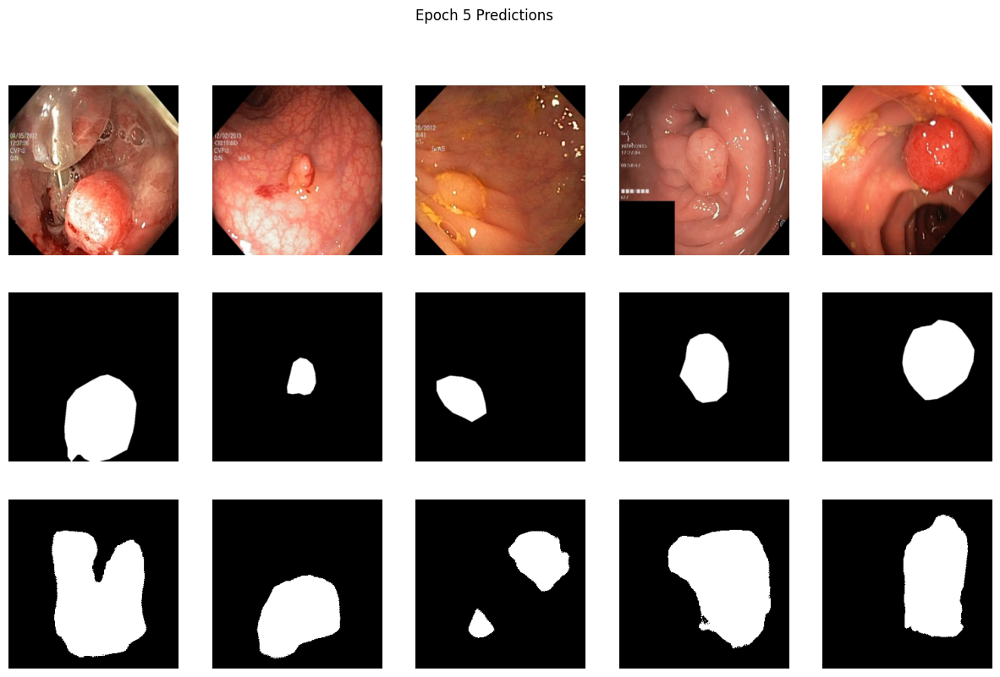

Epoch 6/250 | Train Loss: 1.0424 | Val Loss: 0.9733 | IoU: 0.3219
Saved best model at epoch 6
Epoch 7/250 | Train Loss: 1.0391 | Val Loss: 0.9638 | IoU: 0.3352
Saved best model at epoch 7
Epoch 8/250 | Train Loss: 1.0281 | Val Loss: 0.9486 | IoU: 0.3677
Saved best model at epoch 8
Epoch 9/250 | Train Loss: 1.0107 | Val Loss: 0.9354 | IoU: 0.3034
Saved best model at epoch 9
Epoch 10/250 | Train Loss: 0.9994 | Val Loss: 0.9155 | IoU: 0.3355
Saved best model at epoch 10


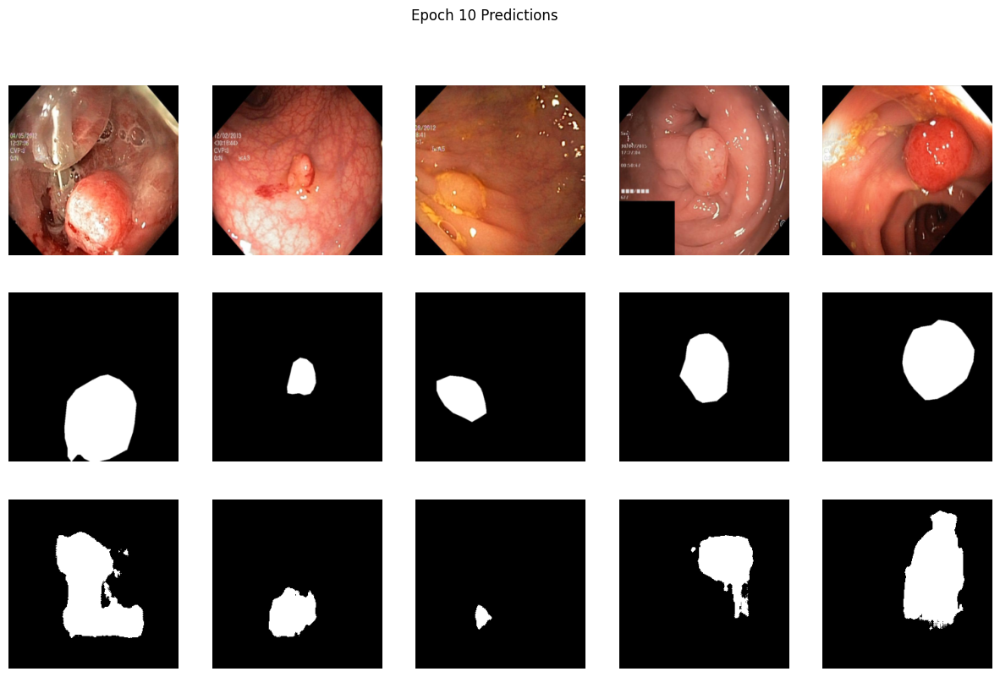

Epoch 11/250 | Train Loss: 0.9980 | Val Loss: 0.9569 | IoU: 0.3446
Epoch 12/250 | Train Loss: 0.9923 | Val Loss: 0.9439 | IoU: 0.2991
Epoch 13/250 | Train Loss: 0.9725 | Val Loss: 0.9214 | IoU: 0.2969
Epoch 14/250 | Train Loss: 0.9731 | Val Loss: 0.8627 | IoU: 0.3803
Saved best model at epoch 14
Epoch 15/250 | Train Loss: 0.9752 | Val Loss: 0.9558 | IoU: 0.2990


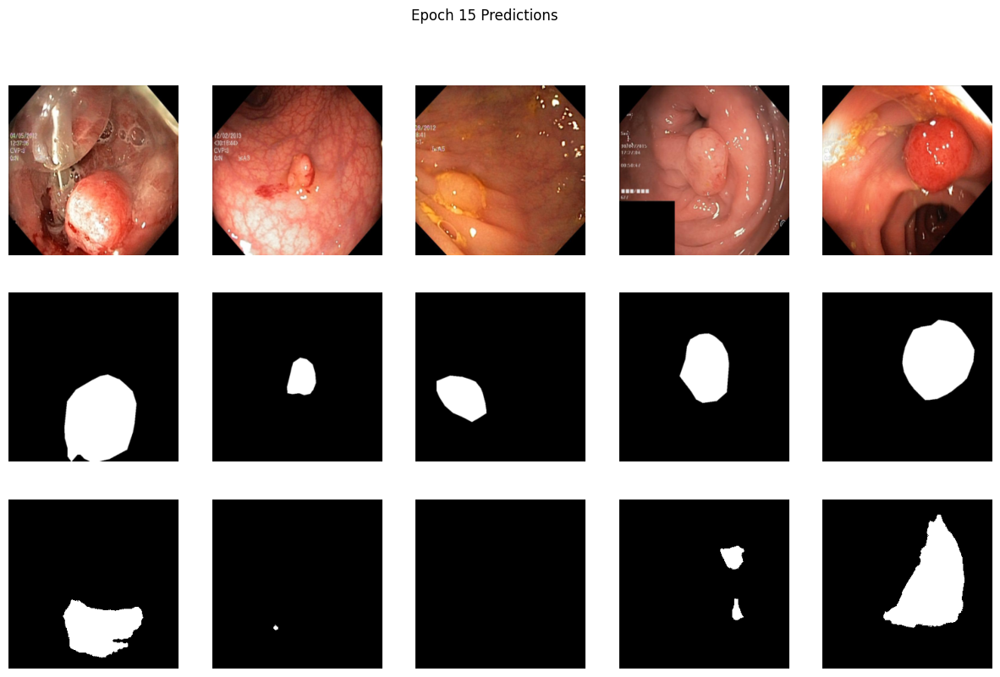

Epoch 16/250 | Train Loss: 0.9602 | Val Loss: 0.8460 | IoU: 0.3873
Saved best model at epoch 16
Epoch 17/250 | Train Loss: 0.9589 | Val Loss: 0.9820 | IoU: 0.2402
Epoch 18/250 | Train Loss: 0.9545 | Val Loss: 0.8524 | IoU: 0.3901
Epoch 19/250 | Train Loss: 0.9509 | Val Loss: 0.9445 | IoU: 0.3867
Epoch 20/250 | Train Loss: 0.9517 | Val Loss: 0.8402 | IoU: 0.4423
Saved best model at epoch 20


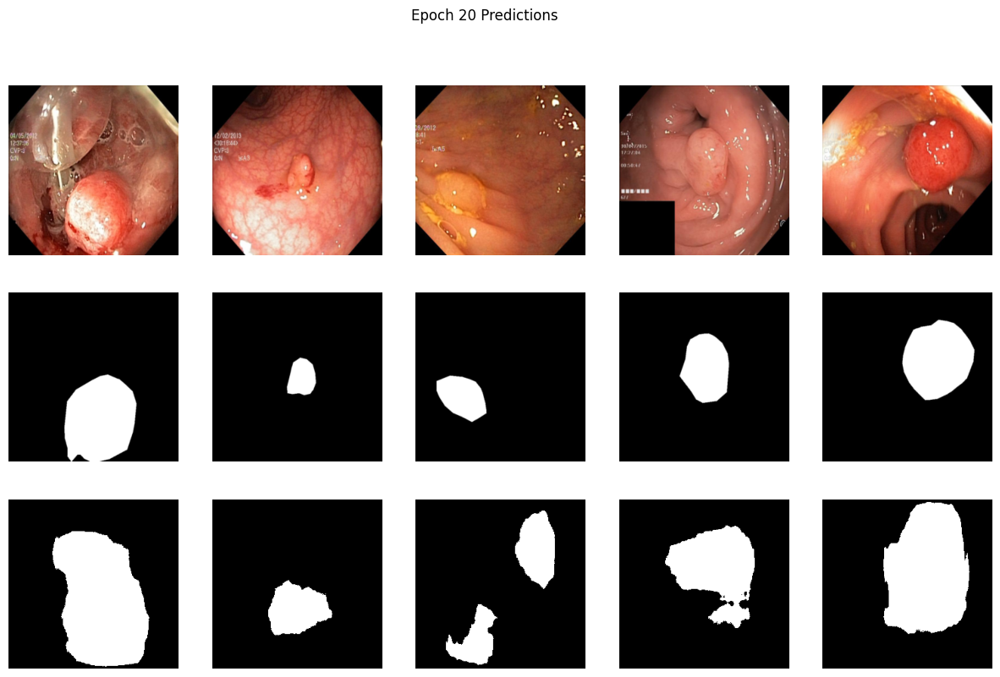

Epoch 21/250 | Train Loss: 0.9447 | Val Loss: 0.9888 | IoU: 0.2762
Epoch 22/250 | Train Loss: 0.9505 | Val Loss: 0.7895 | IoU: 0.4521
Saved best model at epoch 22
Epoch 23/250 | Train Loss: 0.9314 | Val Loss: 0.8078 | IoU: 0.4261
Epoch 24/250 | Train Loss: 0.9330 | Val Loss: 0.8195 | IoU: 0.3869
Epoch 25/250 | Train Loss: 0.9397 | Val Loss: 0.8286 | IoU: 0.4003


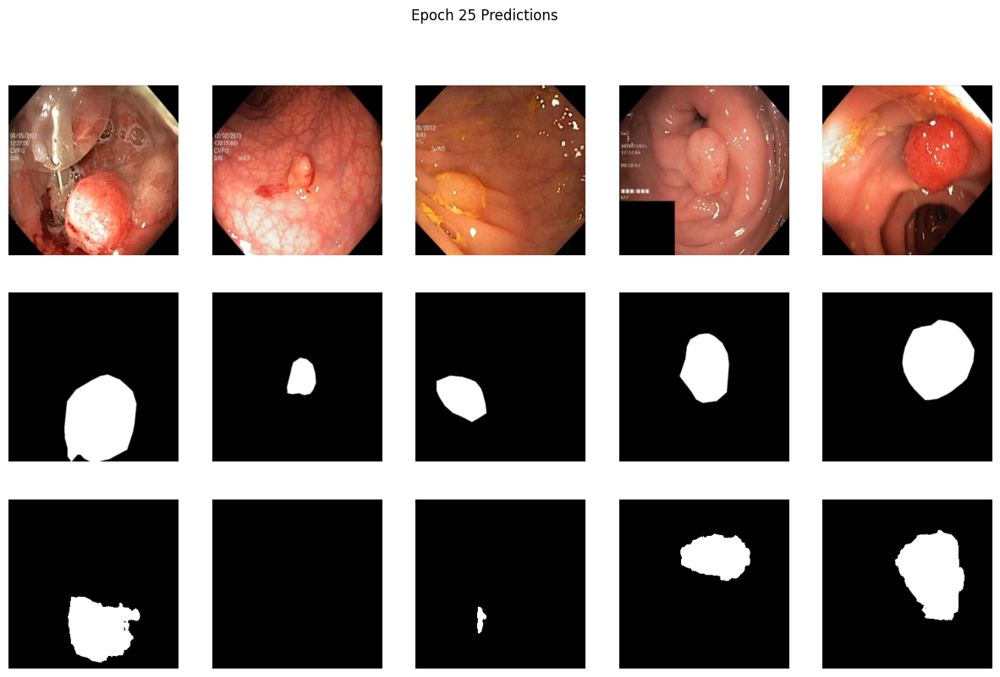

Epoch 26/250 | Train Loss: 0.9305 | Val Loss: 0.7731 | IoU: 0.4740
Saved best model at epoch 26
Epoch 27/250 | Train Loss: 0.9185 | Val Loss: 0.7337 | IoU: 0.4631
Saved best model at epoch 27
Epoch 28/250 | Train Loss: 0.9234 | Val Loss: 0.7969 | IoU: 0.4485
Epoch 29/250 | Train Loss: 0.9189 | Val Loss: 0.8403 | IoU: 0.3864
Epoch 30/250 | Train Loss: 0.9106 | Val Loss: 0.7223 | IoU: 0.4938
Saved best model at epoch 30


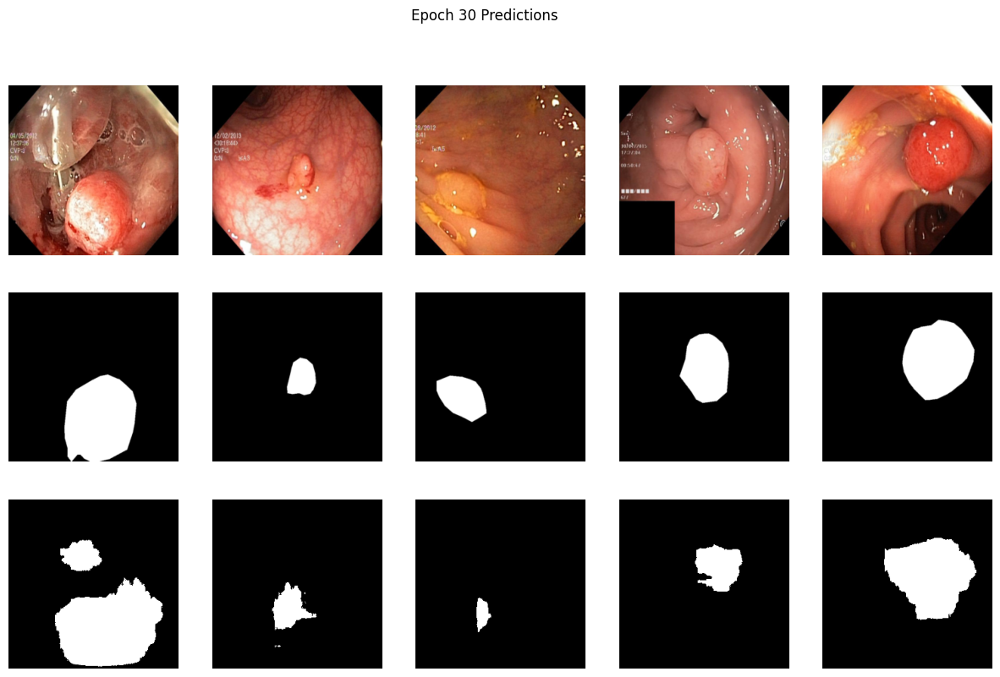

Epoch 31/250 | Train Loss: 0.9162 | Val Loss: 0.7234 | IoU: 0.4800
Epoch 32/250 | Train Loss: 0.8971 | Val Loss: 0.7016 | IoU: 0.4876
Saved best model at epoch 32
Epoch 33/250 | Train Loss: 0.9070 | Val Loss: 0.7725 | IoU: 0.4690
Epoch 34/250 | Train Loss: 0.9076 | Val Loss: 0.8331 | IoU: 0.4423
Epoch 35/250 | Train Loss: 0.8830 | Val Loss: 0.7222 | IoU: 0.4746


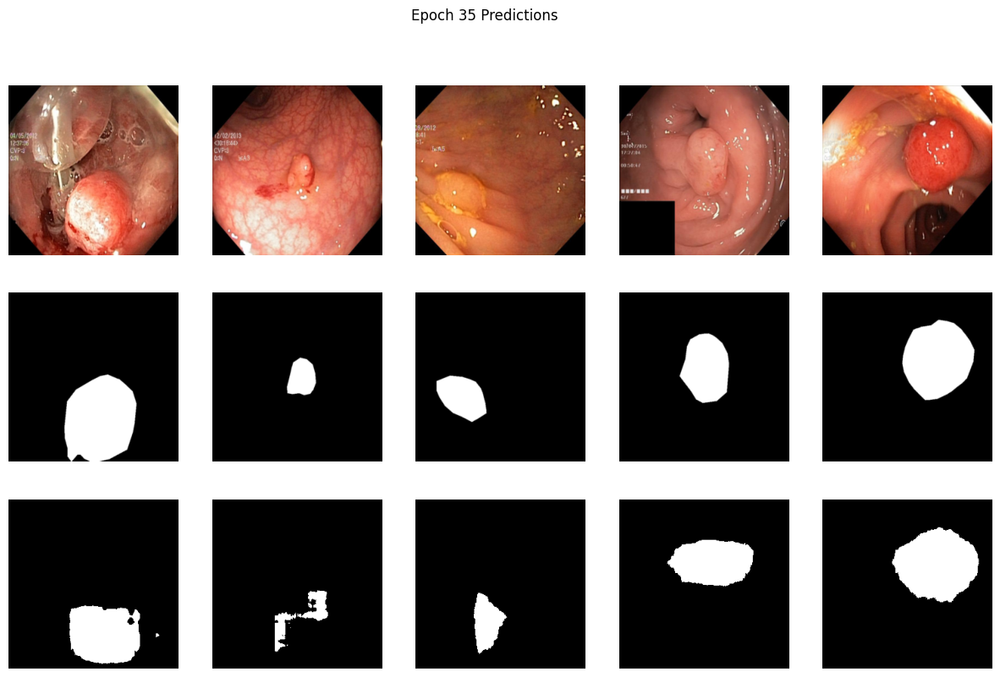

Epoch 36/250 | Train Loss: 0.8954 | Val Loss: 0.7603 | IoU: 0.4744
Epoch 37/250 | Train Loss: 0.8871 | Val Loss: 0.7207 | IoU: 0.4862
Epoch 38/250 | Train Loss: 0.8812 | Val Loss: 0.6870 | IoU: 0.5005
Saved best model at epoch 38
Epoch 39/250 | Train Loss: 0.8901 | Val Loss: 0.6627 | IoU: 0.5255
Saved best model at epoch 39
Epoch 40/250 | Train Loss: 0.8799 | Val Loss: 0.7429 | IoU: 0.4678


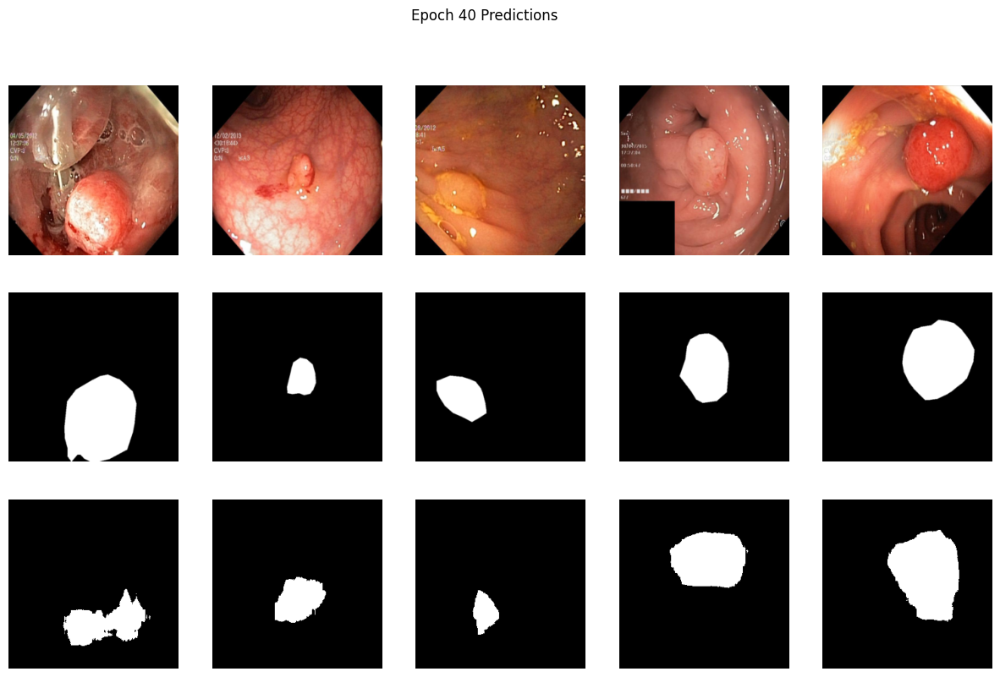

Epoch 41/250 | Train Loss: 0.8873 | Val Loss: 0.7138 | IoU: 0.4962
Epoch 42/250 | Train Loss: 0.8823 | Val Loss: 0.7297 | IoU: 0.4814
Epoch 43/250 | Train Loss: 0.8596 | Val Loss: 0.7090 | IoU: 0.4991
Epoch 44/250 | Train Loss: 0.8764 | Val Loss: 0.6492 | IoU: 0.5297
Saved best model at epoch 44
Epoch 45/250 | Train Loss: 0.8659 | Val Loss: 0.6994 | IoU: 0.4831


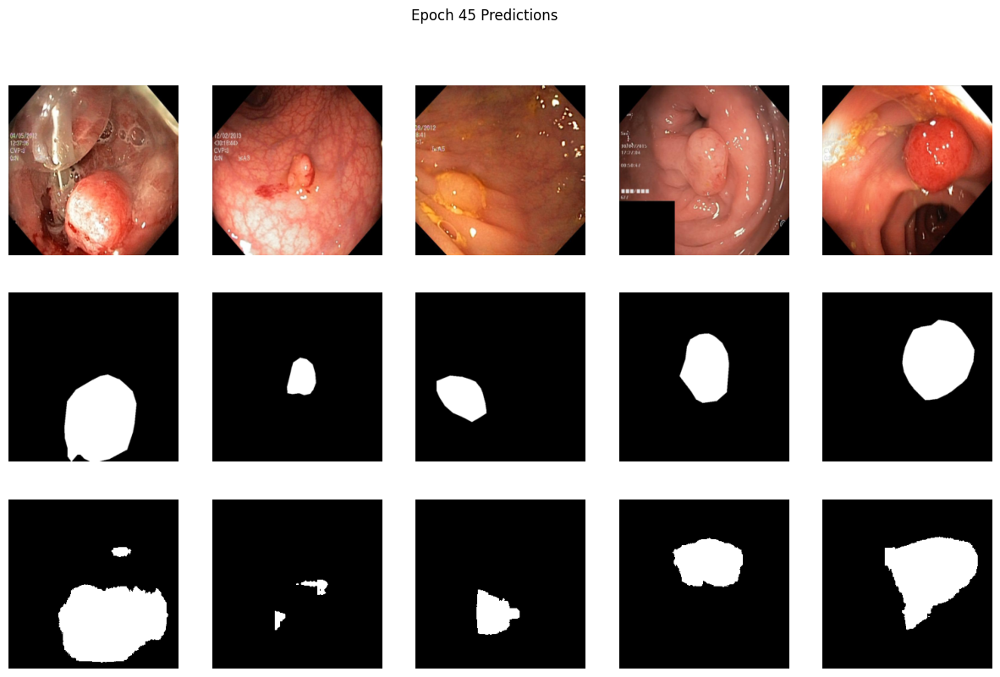

Epoch 46/250 | Train Loss: 0.8674 | Val Loss: 0.6646 | IoU: 0.5271
Epoch 47/250 | Train Loss: 0.8758 | Val Loss: 0.6709 | IoU: 0.5135
Epoch 48/250 | Train Loss: 0.8559 | Val Loss: 0.6480 | IoU: 0.5340
Saved best model at epoch 48
Epoch 49/250 | Train Loss: 0.8536 | Val Loss: 0.6623 | IoU: 0.5189
Epoch 50/250 | Train Loss: 0.8581 | Val Loss: 0.6510 | IoU: 0.5313


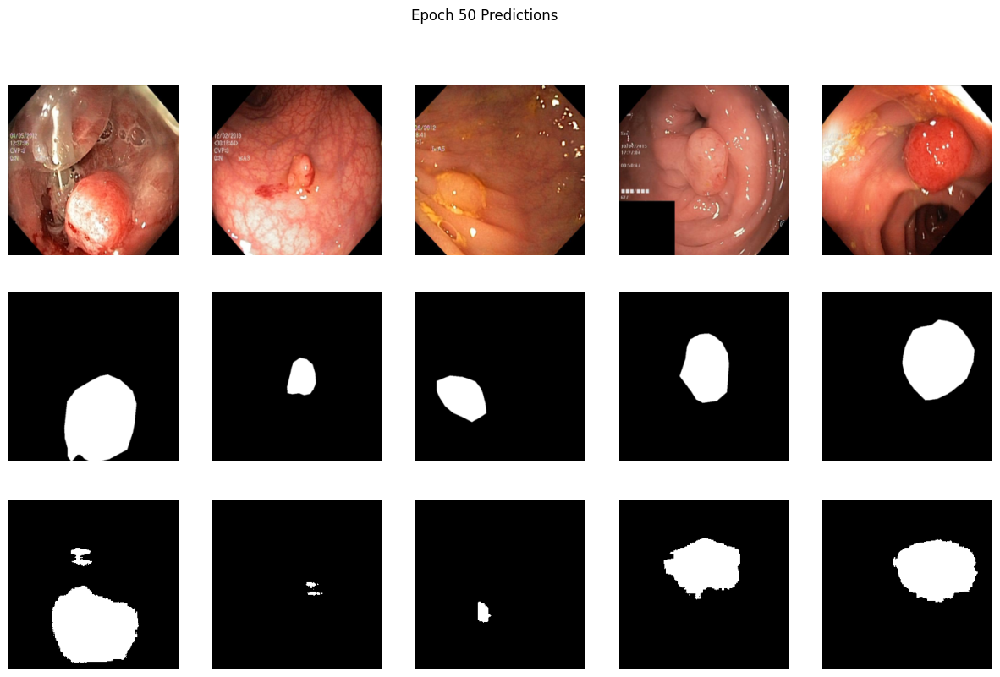

Epoch 51/250 | Train Loss: 0.8438 | Val Loss: 0.6394 | IoU: 0.5314
Saved best model at epoch 51
Epoch 52/250 | Train Loss: 0.8340 | Val Loss: 0.6434 | IoU: 0.5351
Epoch 53/250 | Train Loss: 0.8327 | Val Loss: 0.6269 | IoU: 0.5483
Saved best model at epoch 53
Epoch 54/250 | Train Loss: 0.8497 | Val Loss: 0.6245 | IoU: 0.5352
Saved best model at epoch 54
Epoch 55/250 | Train Loss: 0.8386 | Val Loss: 0.6081 | IoU: 0.5626
Saved best model at epoch 55


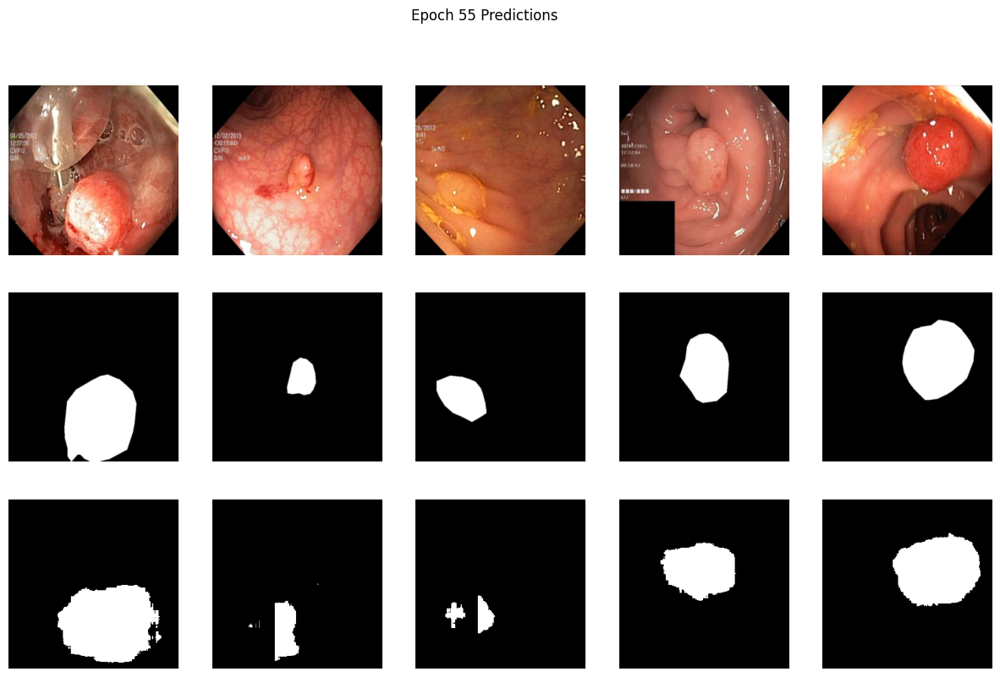

Epoch 56/250 | Train Loss: 0.8284 | Val Loss: 0.6182 | IoU: 0.5430
Epoch 57/250 | Train Loss: 0.8207 | Val Loss: 0.6328 | IoU: 0.5383
Epoch 58/250 | Train Loss: 0.8222 | Val Loss: 0.7011 | IoU: 0.4975
Epoch 59/250 | Train Loss: 0.8174 | Val Loss: 0.6640 | IoU: 0.5056
Epoch 60/250 | Train Loss: 0.8189 | Val Loss: 0.6309 | IoU: 0.5410


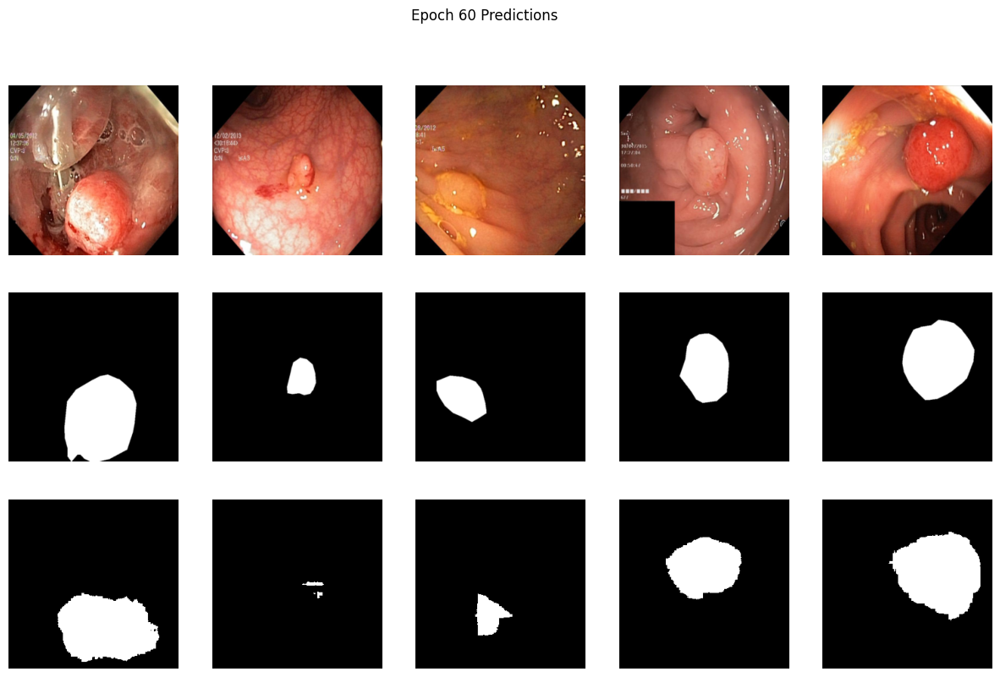

Epoch 61/250 | Train Loss: 0.8148 | Val Loss: 0.5929 | IoU: 0.5579
Saved best model at epoch 61
Epoch 62/250 | Train Loss: 0.7977 | Val Loss: 0.6509 | IoU: 0.5167
Epoch 63/250 | Train Loss: 0.8216 | Val Loss: 0.5921 | IoU: 0.5613
Saved best model at epoch 63
Epoch 64/250 | Train Loss: 0.8045 | Val Loss: 0.6114 | IoU: 0.5499
Epoch 65/250 | Train Loss: 0.8023 | Val Loss: 0.6086 | IoU: 0.5495


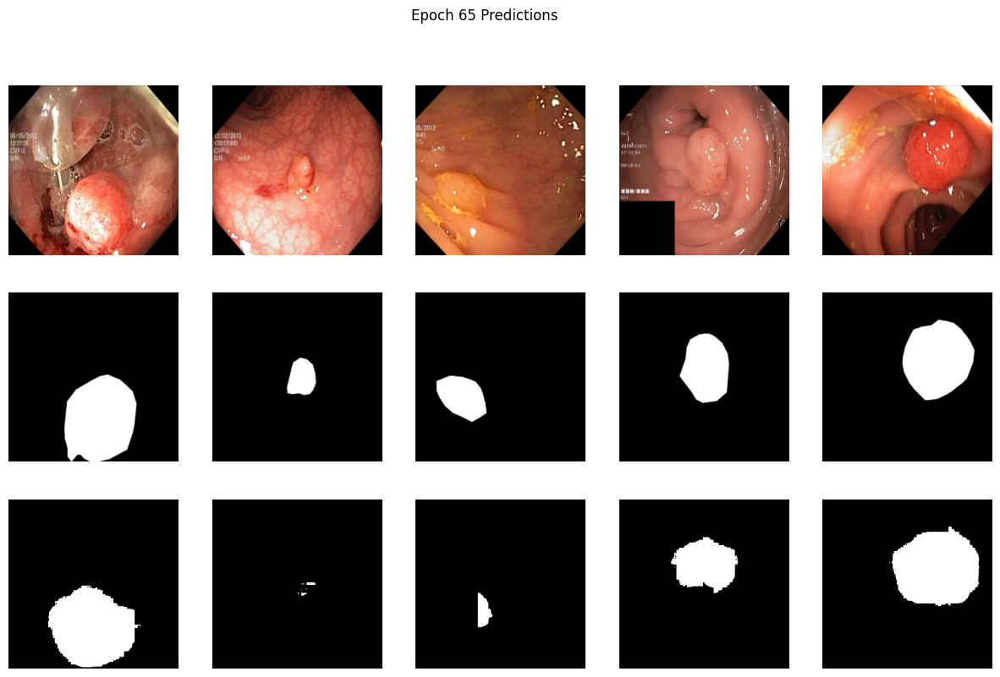

Epoch 66/250 | Train Loss: 0.7993 | Val Loss: 0.5886 | IoU: 0.5609
Saved best model at epoch 66
Epoch 67/250 | Train Loss: 0.7890 | Val Loss: 0.6169 | IoU: 0.5351
Epoch 68/250 | Train Loss: 0.7971 | Val Loss: 0.6413 | IoU: 0.5368
Epoch 69/250 | Train Loss: 0.7794 | Val Loss: 0.5660 | IoU: 0.5717
Saved best model at epoch 69
Epoch 70/250 | Train Loss: 0.8024 | Val Loss: 0.5683 | IoU: 0.5716


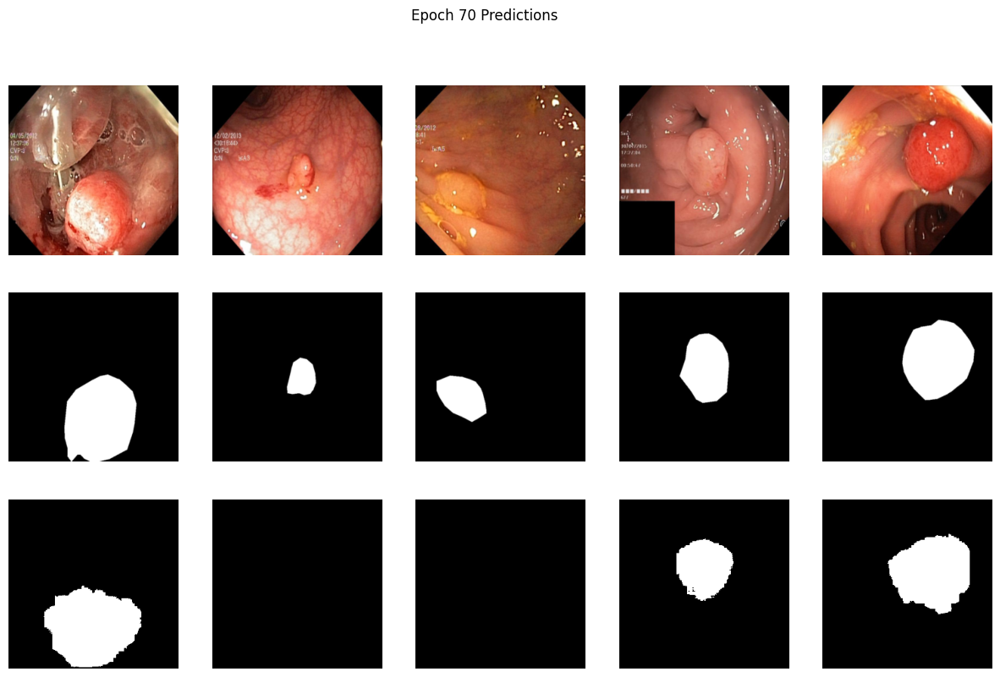

Epoch 71/250 | Train Loss: 0.7870 | Val Loss: 0.6154 | IoU: 0.5436
Epoch 72/250 | Train Loss: 0.7763 | Val Loss: 0.5626 | IoU: 0.5759
Saved best model at epoch 72
Epoch 73/250 | Train Loss: 0.7705 | Val Loss: 0.5817 | IoU: 0.5645
Epoch 74/250 | Train Loss: 0.7578 | Val Loss: 0.5607 | IoU: 0.5815
Saved best model at epoch 74
Epoch 75/250 | Train Loss: 0.7555 | Val Loss: 0.5584 | IoU: 0.5828
Saved best model at epoch 75


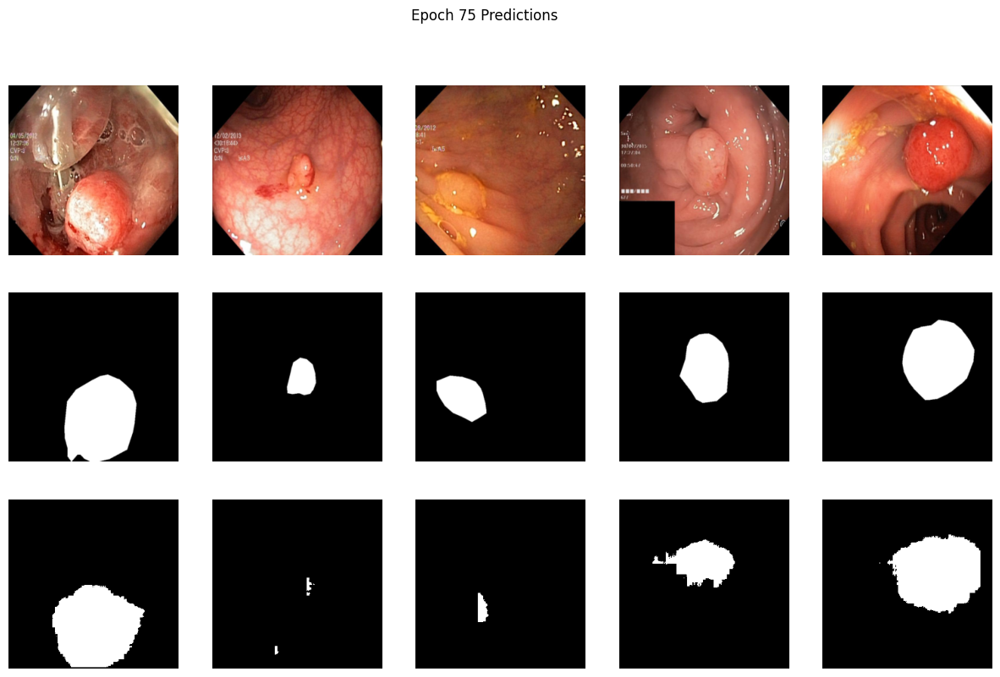

Epoch 76/250 | Train Loss: 0.7653 | Val Loss: 0.5860 | IoU: 0.5643
Epoch 77/250 | Train Loss: 0.7689 | Val Loss: 0.6125 | IoU: 0.5452
Epoch 78/250 | Train Loss: 0.7532 | Val Loss: 0.6011 | IoU: 0.5536
Epoch 79/250 | Train Loss: 0.7548 | Val Loss: 0.5482 | IoU: 0.5939
Saved best model at epoch 79
Epoch 80/250 | Train Loss: 0.7447 | Val Loss: 0.5679 | IoU: 0.5637


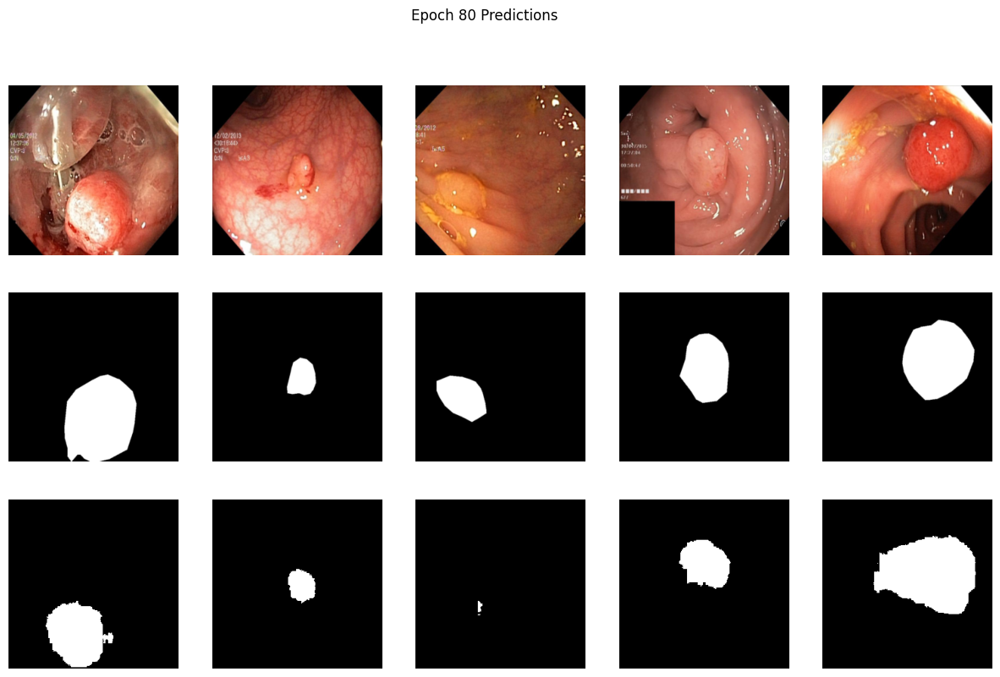

Epoch 81/250 | Train Loss: 0.7511 | Val Loss: 0.5802 | IoU: 0.5643
Epoch 82/250 | Train Loss: 0.7472 | Val Loss: 0.5809 | IoU: 0.5610
Epoch 83/250 | Train Loss: 0.7173 | Val Loss: 0.5427 | IoU: 0.5840
Saved best model at epoch 83
Epoch 84/250 | Train Loss: 0.7451 | Val Loss: 0.5642 | IoU: 0.5753
Epoch 85/250 | Train Loss: 0.7366 | Val Loss: 0.6062 | IoU: 0.5462


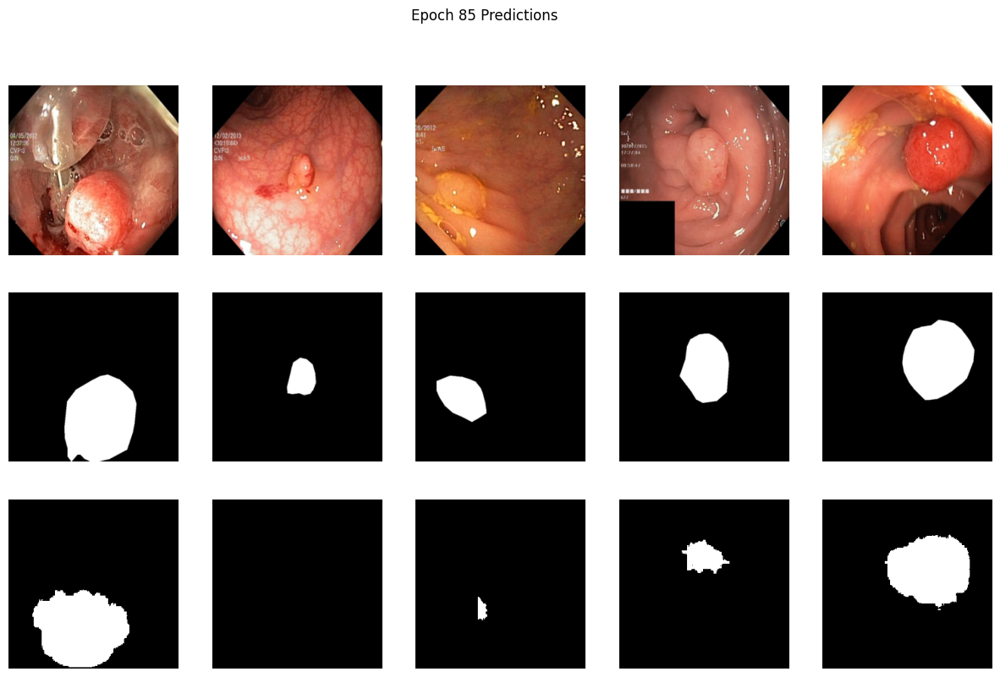

Epoch 86/250 | Train Loss: 0.7454 | Val Loss: 0.5850 | IoU: 0.5649
Epoch 87/250 | Train Loss: 0.7187 | Val Loss: 0.6832 | IoU: 0.4914
Epoch 88/250 | Train Loss: 0.7436 | Val Loss: 0.5783 | IoU: 0.5671
Epoch 89/250 | Train Loss: 0.7132 | Val Loss: 0.5567 | IoU: 0.5825
Epoch 90/250 | Train Loss: 0.6953 | Val Loss: 0.6007 | IoU: 0.5473


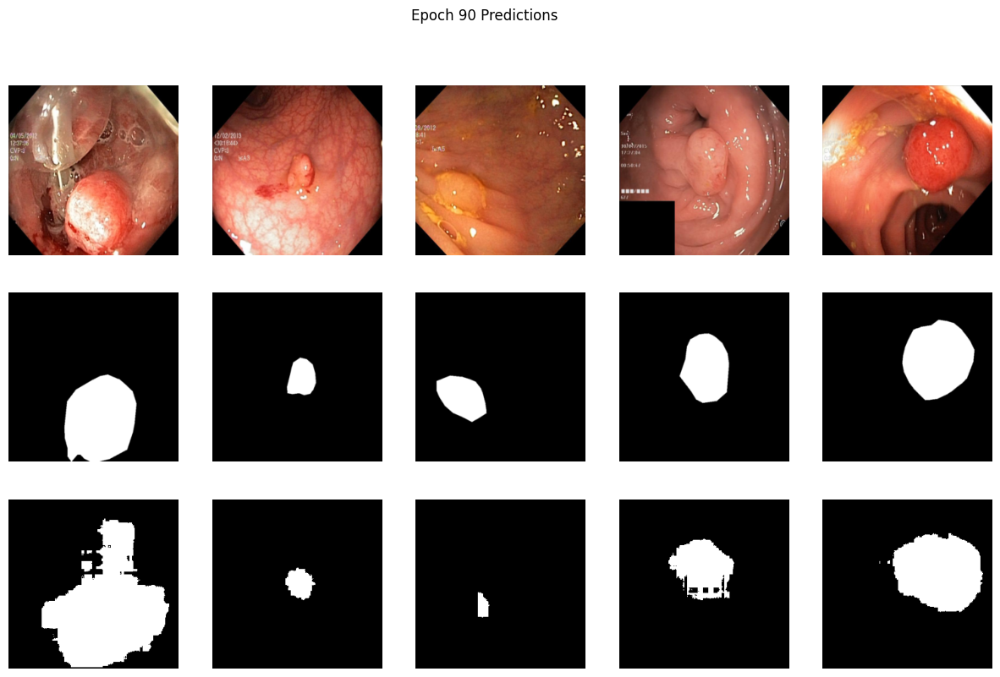

Epoch 91/250 | Train Loss: 0.7071 | Val Loss: 0.6430 | IoU: 0.5324
Epoch 92/250 | Train Loss: 0.7179 | Val Loss: 0.5531 | IoU: 0.5908
Epoch 93/250 | Train Loss: 0.7105 | Val Loss: 0.6362 | IoU: 0.5448
Epoch 94/250 | Train Loss: 0.6986 | Val Loss: 0.5652 | IoU: 0.5770
Epoch 95/250 | Train Loss: 0.6897 | Val Loss: 0.5598 | IoU: 0.5715


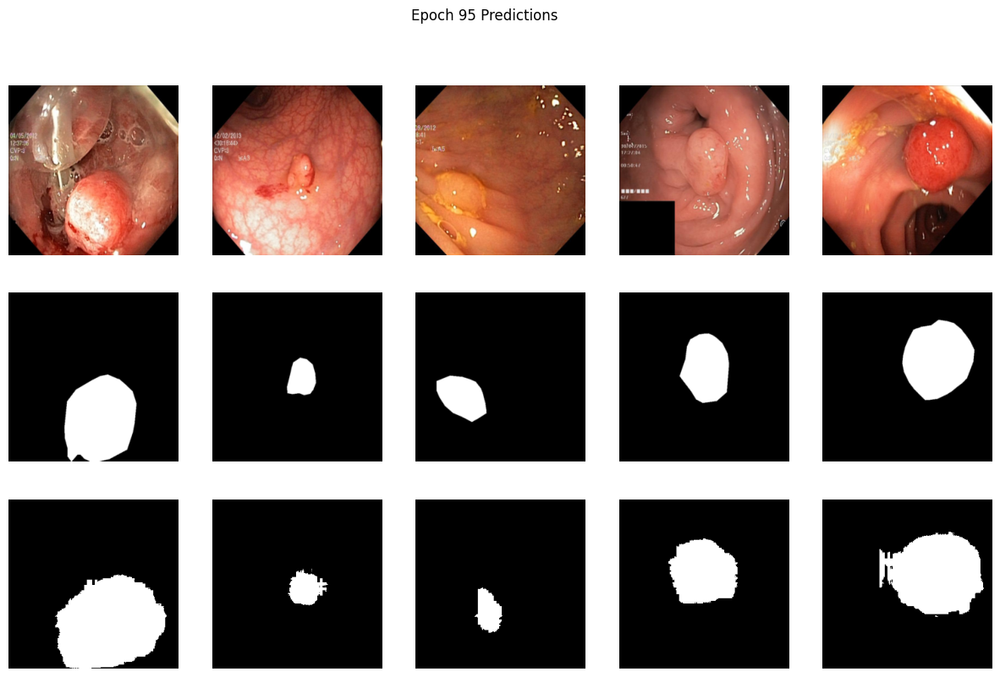

Epoch 96/250 | Train Loss: 0.7040 | Val Loss: 0.5666 | IoU: 0.5795
Epoch 97/250 | Train Loss: 0.6914 | Val Loss: 0.6279 | IoU: 0.5367
Epoch 98/250 | Train Loss: 0.6863 | Val Loss: 0.5792 | IoU: 0.5675
Epoch 99/250 | Train Loss: 0.6852 | Val Loss: 0.5635 | IoU: 0.5757
Epoch 100/250 | Train Loss: 0.6711 | Val Loss: 0.5817 | IoU: 0.5672


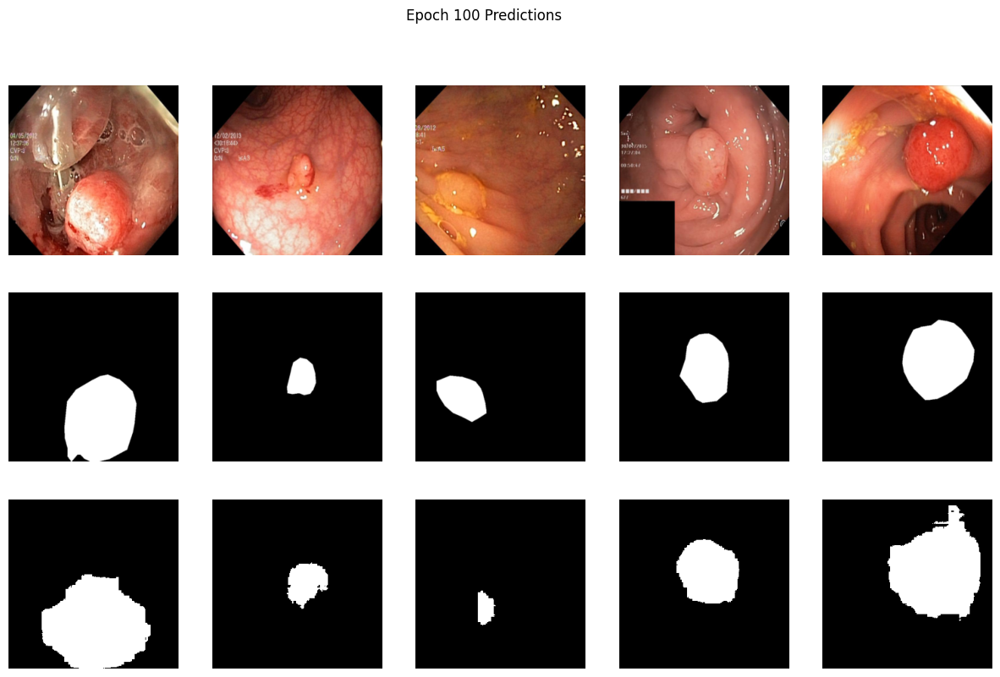

Epoch 101/250 | Train Loss: 0.6614 | Val Loss: 0.5686 | IoU: 0.5723
Epoch 102/250 | Train Loss: 0.6665 | Val Loss: 0.5837 | IoU: 0.5658
Epoch 103/250 | Train Loss: 0.6805 | Val Loss: 0.5804 | IoU: 0.5587
Epoch 104/250 | Train Loss: 0.6652 | Val Loss: 0.5617 | IoU: 0.5811
Epoch 105/250 | Train Loss: 0.6588 | Val Loss: 0.5182 | IoU: 0.6067
Saved best model at epoch 105


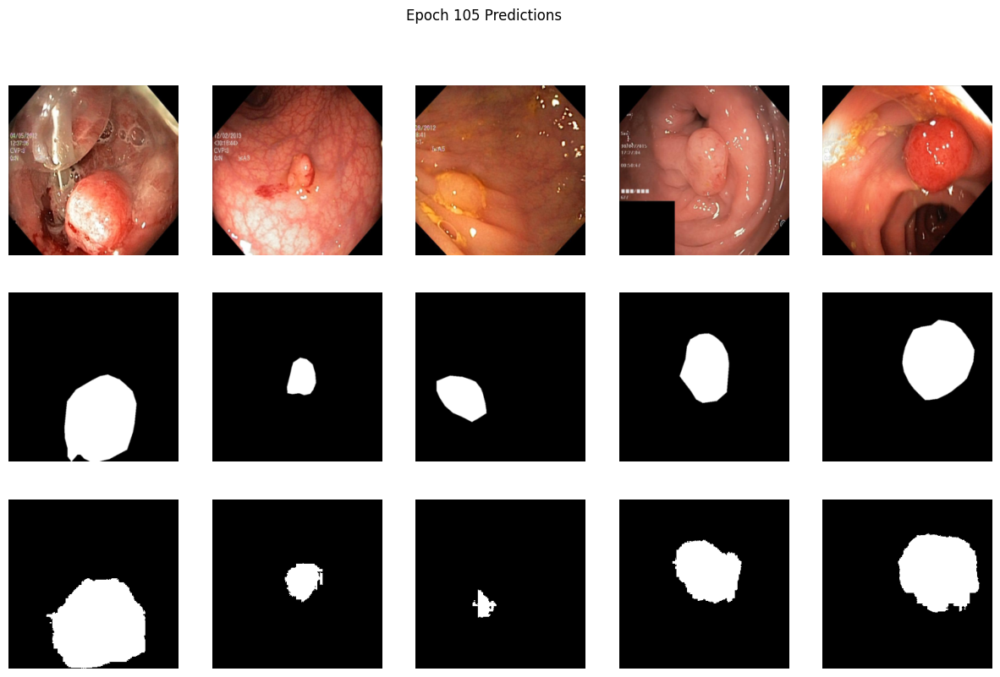

Epoch 106/250 | Train Loss: 0.6574 | Val Loss: 0.5371 | IoU: 0.5969
Epoch 107/250 | Train Loss: 0.6631 | Val Loss: 0.5973 | IoU: 0.5609
Epoch 108/250 | Train Loss: 0.6561 | Val Loss: 0.5366 | IoU: 0.5858
Epoch 109/250 | Train Loss: 0.6500 | Val Loss: 0.6039 | IoU: 0.5491
Epoch 110/250 | Train Loss: 0.6667 | Val Loss: 0.5354 | IoU: 0.5928


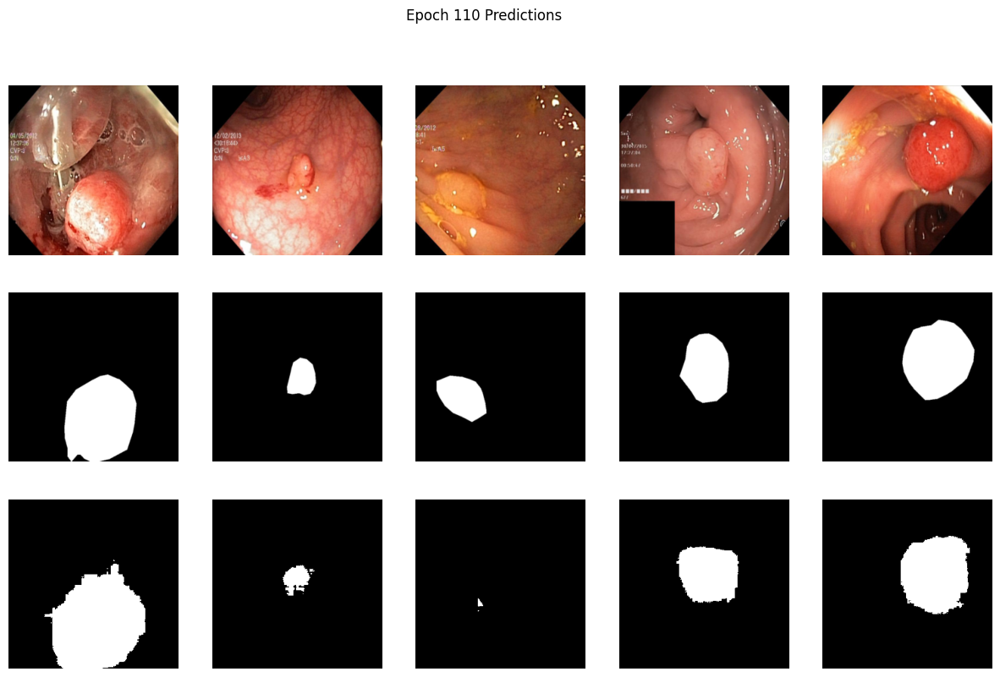

Epoch 111/250 | Train Loss: 0.6395 | Val Loss: 0.5870 | IoU: 0.5638
Epoch 112/250 | Train Loss: 0.6419 | Val Loss: 0.5600 | IoU: 0.5809
Epoch 113/250 | Train Loss: 0.6314 | Val Loss: 0.5819 | IoU: 0.5576
Epoch 114/250 | Train Loss: 0.6439 | Val Loss: 0.5642 | IoU: 0.5796
Epoch 115/250 | Train Loss: 0.6340 | Val Loss: 0.6176 | IoU: 0.5416


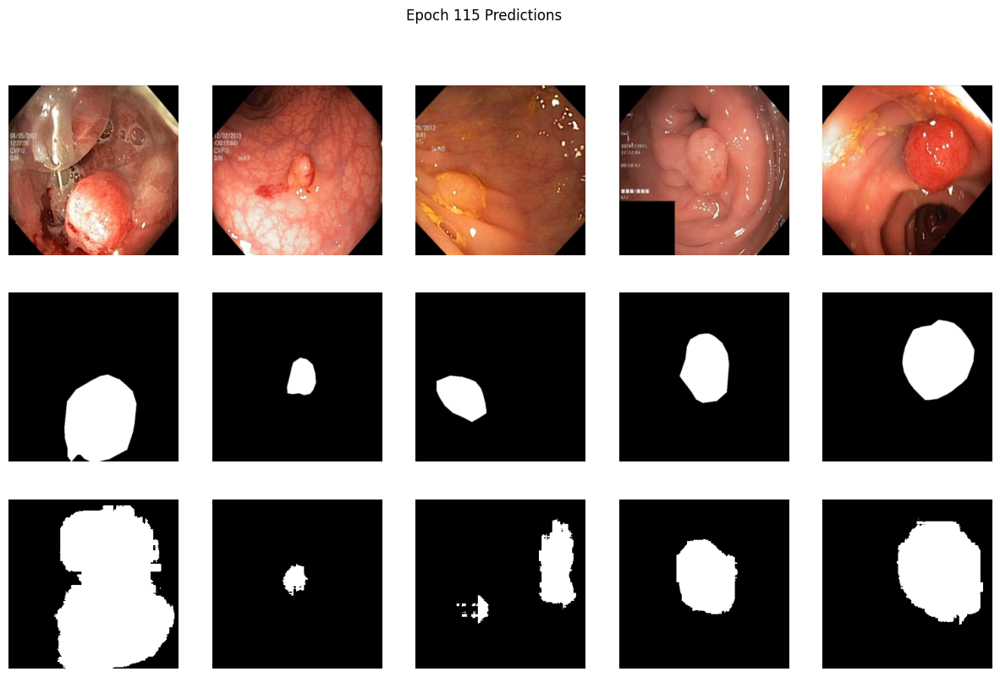

Epoch 116/250 | Train Loss: 0.6410 | Val Loss: 0.5367 | IoU: 0.5905
Epoch 117/250 | Train Loss: 0.6154 | Val Loss: 0.5012 | IoU: 0.6103
Saved best model at epoch 117
Epoch 118/250 | Train Loss: 0.6093 | Val Loss: 0.4947 | IoU: 0.6225
Saved best model at epoch 118
Epoch 119/250 | Train Loss: 0.6271 | Val Loss: 0.5221 | IoU: 0.6049
Epoch 120/250 | Train Loss: 0.5997 | Val Loss: 0.5170 | IoU: 0.6039


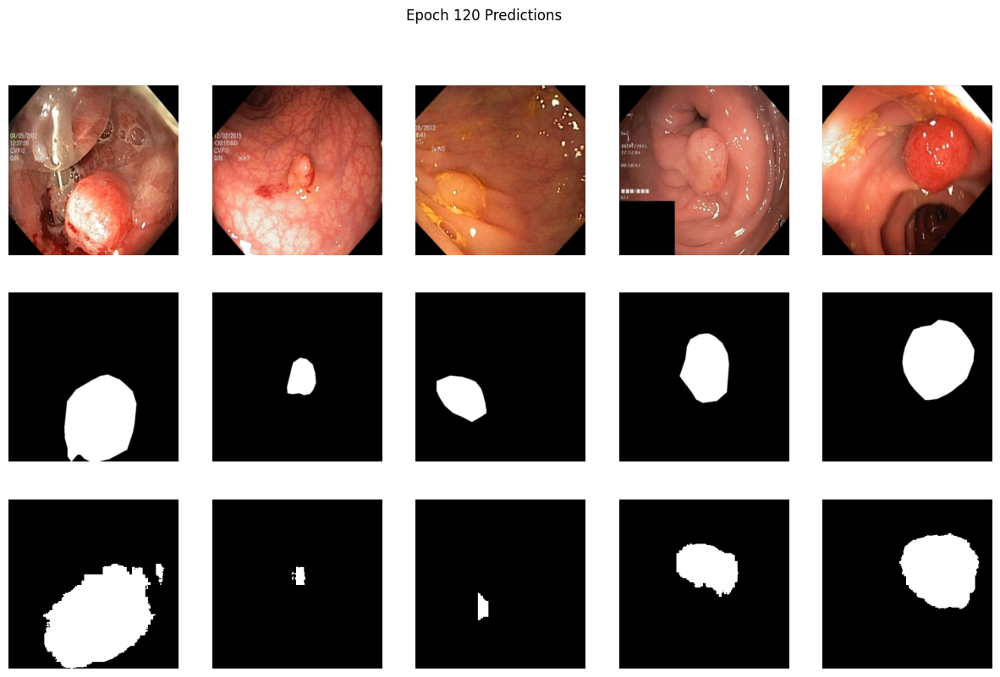

Epoch 121/250 | Train Loss: 0.6168 | Val Loss: 0.5669 | IoU: 0.5742
Epoch 122/250 | Train Loss: 0.6073 | Val Loss: 0.5219 | IoU: 0.5999
Epoch 123/250 | Train Loss: 0.6264 | Val Loss: 0.5660 | IoU: 0.5745
Epoch 124/250 | Train Loss: 0.5985 | Val Loss: 0.5534 | IoU: 0.5863
Epoch 125/250 | Train Loss: 0.6045 | Val Loss: 0.5204 | IoU: 0.5993


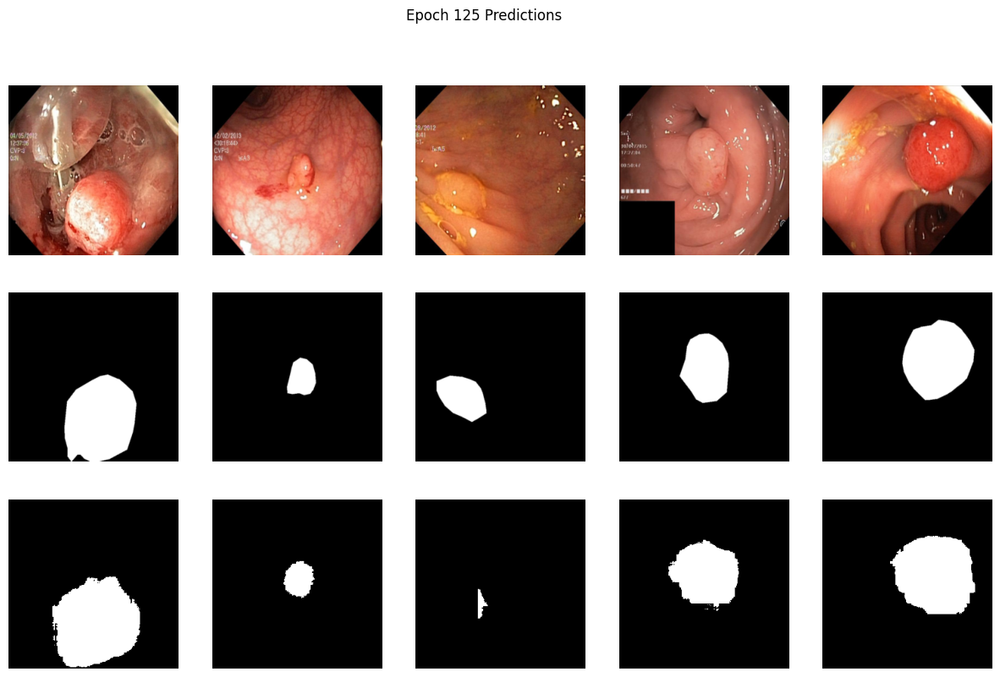

Epoch 126/250 | Train Loss: 0.6124 | Val Loss: 0.5631 | IoU: 0.5828
Epoch 127/250 | Train Loss: 0.5846 | Val Loss: 0.5845 | IoU: 0.5634
Epoch 128/250 | Train Loss: 0.5832 | Val Loss: 0.5766 | IoU: 0.5793
Epoch 129/250 | Train Loss: 0.5862 | Val Loss: 0.5644 | IoU: 0.5821
Epoch 130/250 | Train Loss: 0.5851 | Val Loss: 0.5714 | IoU: 0.5756


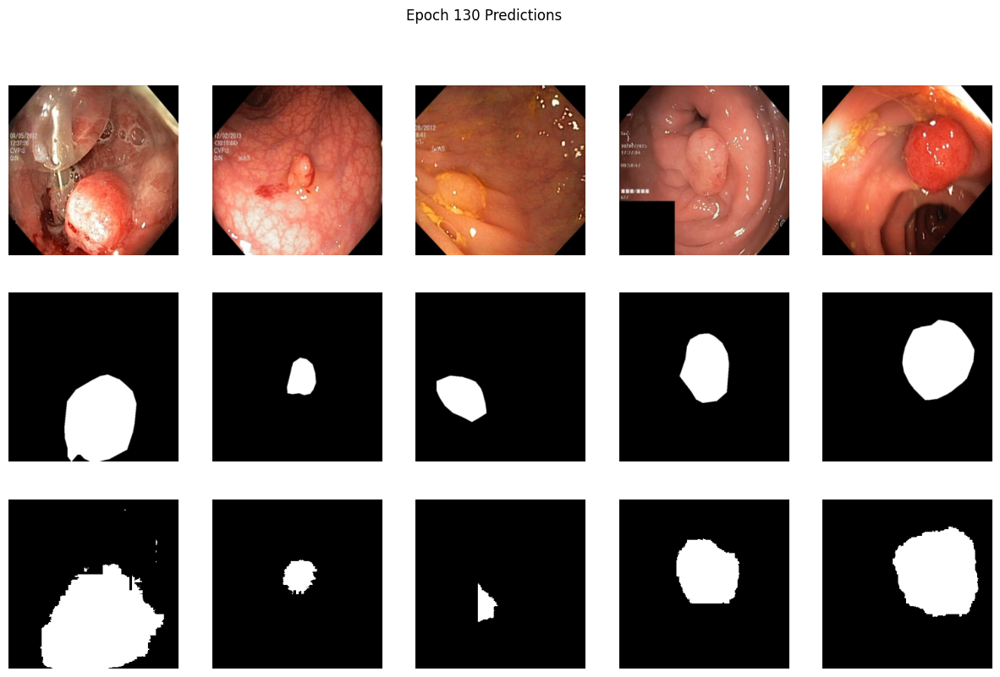

Epoch 131/250 | Train Loss: 0.5775 | Val Loss: 0.5261 | IoU: 0.6057
Epoch 132/250 | Train Loss: 0.5828 | Val Loss: 0.5214 | IoU: 0.6039
Epoch 133/250 | Train Loss: 0.5756 | Val Loss: 0.5538 | IoU: 0.5799
Epoch 134/250 | Train Loss: 0.5670 | Val Loss: 0.6696 | IoU: 0.5199
Epoch 135/250 | Train Loss: 0.5676 | Val Loss: 0.4902 | IoU: 0.6295
Saved best model at epoch 135


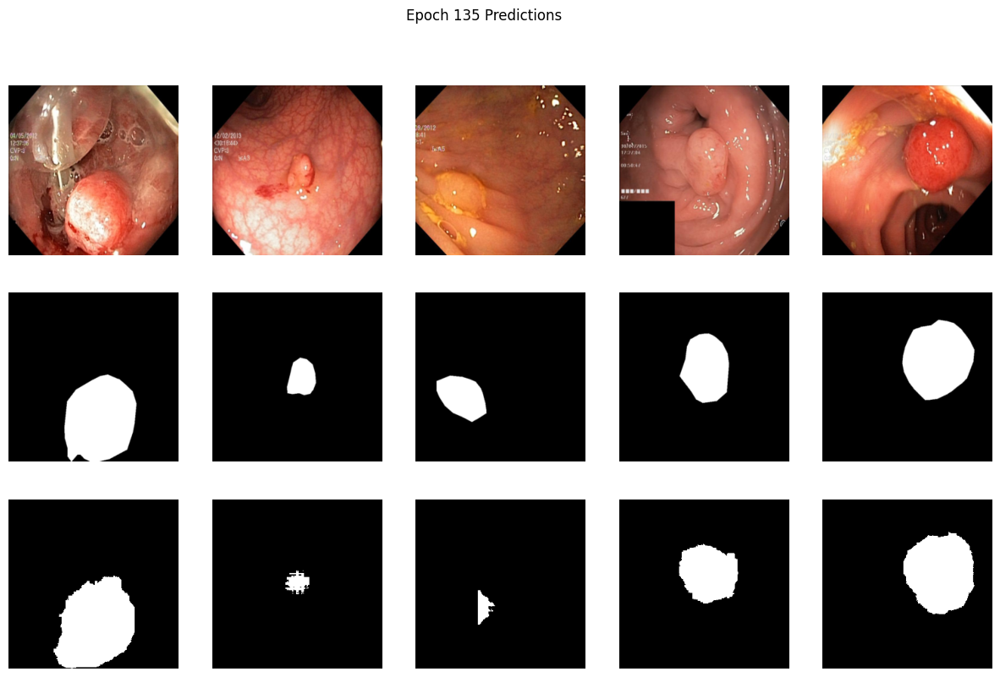

Epoch 136/250 | Train Loss: 0.5853 | Val Loss: 0.5322 | IoU: 0.5913
Epoch 137/250 | Train Loss: 0.5729 | Val Loss: 0.5444 | IoU: 0.5899
Epoch 138/250 | Train Loss: 0.5554 | Val Loss: 0.5358 | IoU: 0.5937
Epoch 139/250 | Train Loss: 0.5791 | Val Loss: 0.5050 | IoU: 0.6191
Epoch 140/250 | Train Loss: 0.5532 | Val Loss: 0.5308 | IoU: 0.5940


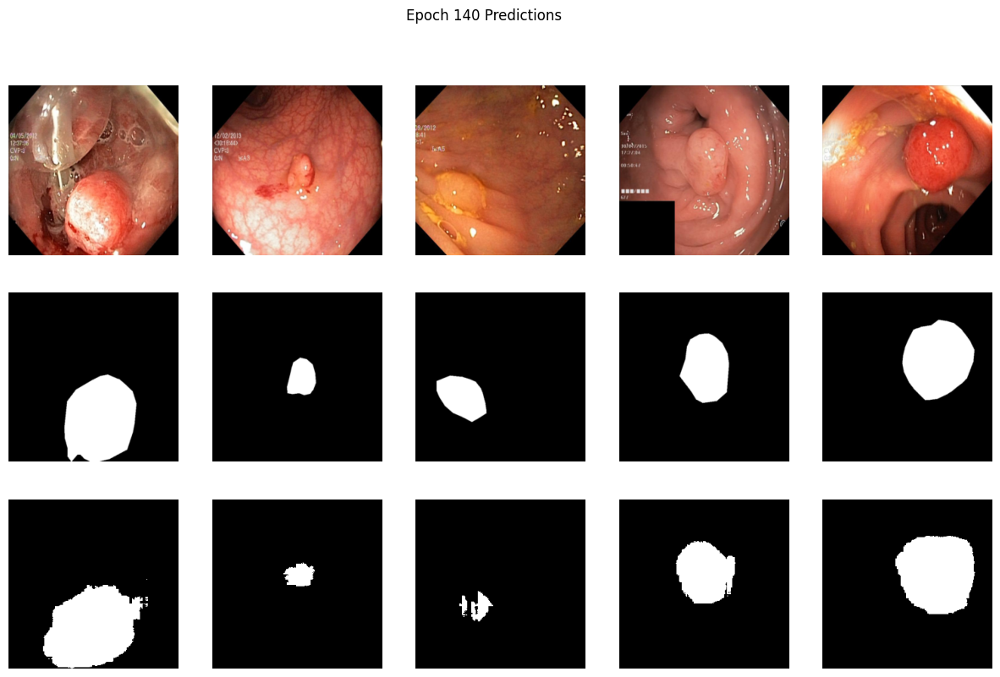

Epoch 141/250 | Train Loss: 0.5465 | Val Loss: 0.5362 | IoU: 0.5906
Epoch 142/250 | Train Loss: 0.5687 | Val Loss: 0.5552 | IoU: 0.5835
Epoch 143/250 | Train Loss: 0.5492 | Val Loss: 0.6000 | IoU: 0.5566
Epoch 144/250 | Train Loss: 0.5622 | Val Loss: 0.5370 | IoU: 0.5902
Epoch 145/250 | Train Loss: 0.5408 | Val Loss: 0.5450 | IoU: 0.5919


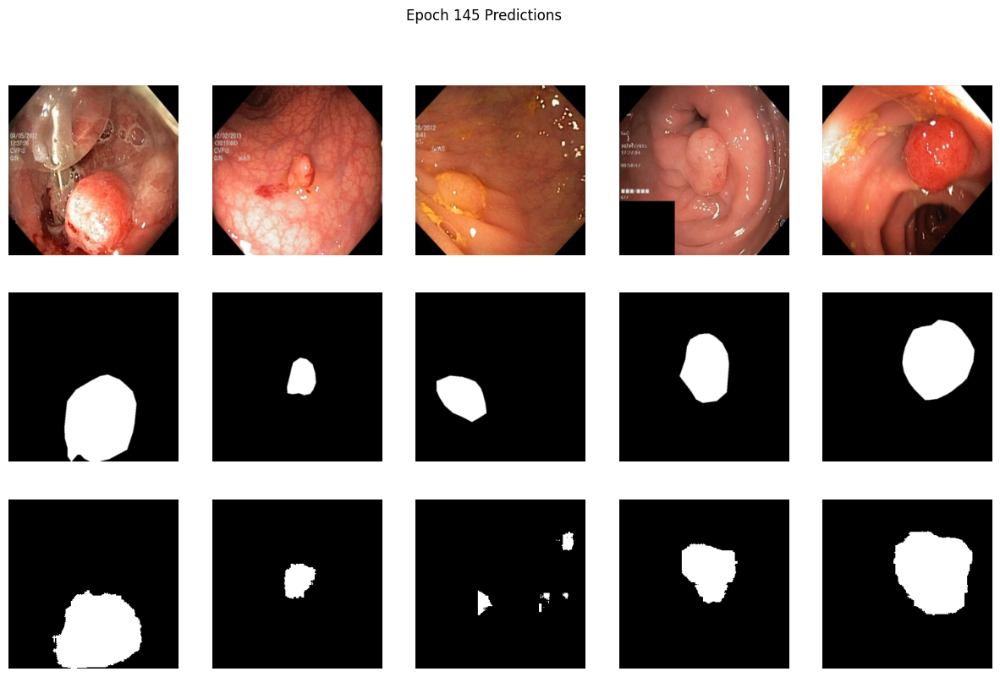

Epoch 146/250 | Train Loss: 0.5337 | Val Loss: 0.5268 | IoU: 0.6060
Epoch 147/250 | Train Loss: 0.5423 | Val Loss: 0.5658 | IoU: 0.5714
Epoch 148/250 | Train Loss: 0.5350 | Val Loss: 0.5804 | IoU: 0.5787
Epoch 149/250 | Train Loss: 0.5239 | Val Loss: 0.5792 | IoU: 0.5639
Epoch 150/250 | Train Loss: 0.5369 | Val Loss: 0.6035 | IoU: 0.5528


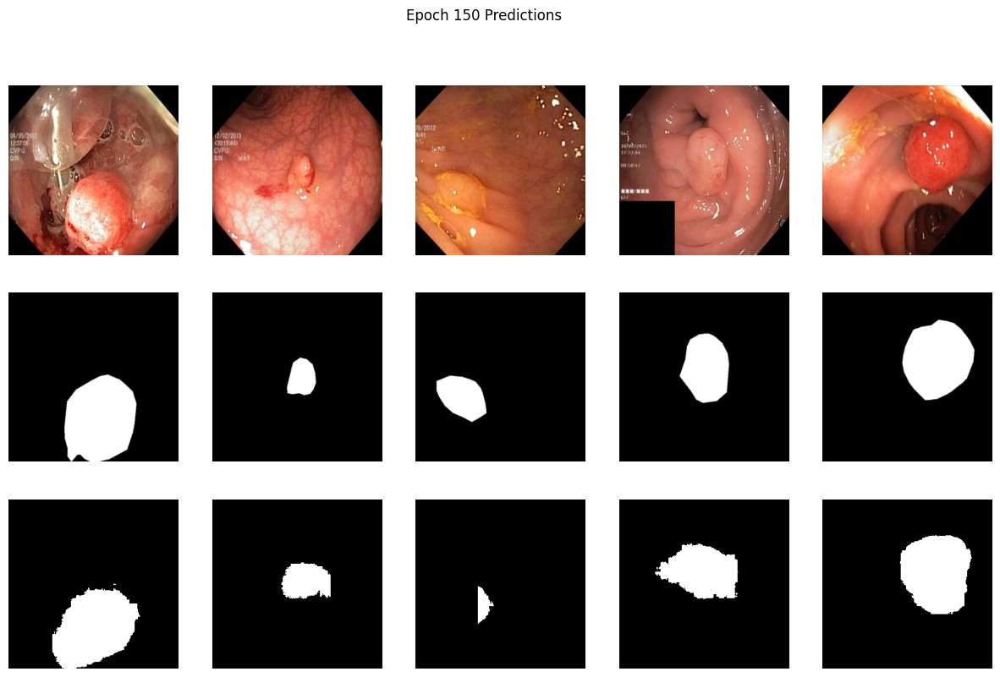

Epoch 151/250 | Train Loss: 0.5255 | Val Loss: 0.5684 | IoU: 0.5841
Epoch 152/250 | Train Loss: 0.5314 | Val Loss: 0.6007 | IoU: 0.5633
Epoch 153/250 | Train Loss: 0.5256 | Val Loss: 0.5774 | IoU: 0.5665
Epoch 154/250 | Train Loss: 0.5179 | Val Loss: 0.5254 | IoU: 0.6011
Epoch 155/250 | Train Loss: 0.5159 | Val Loss: 0.5533 | IoU: 0.5837


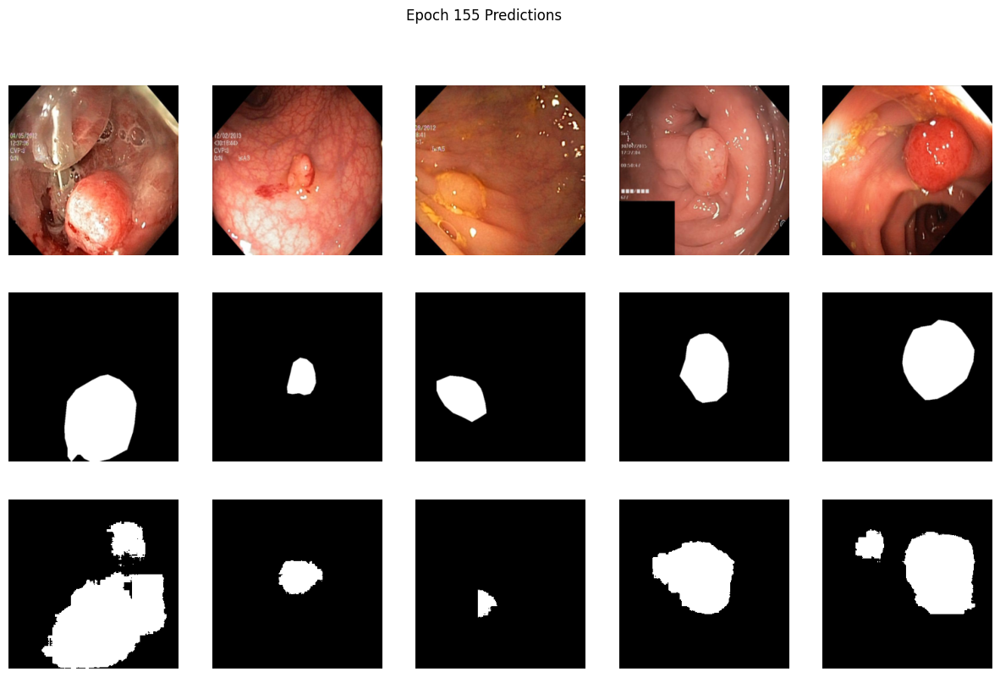

Epoch 156/250 | Train Loss: 0.5056 | Val Loss: 0.6005 | IoU: 0.5540
Epoch 157/250 | Train Loss: 0.5131 | Val Loss: 0.5899 | IoU: 0.5606
Epoch 158/250 | Train Loss: 0.5173 | Val Loss: 0.5556 | IoU: 0.5860
Epoch 159/250 | Train Loss: 0.5135 | Val Loss: 0.6025 | IoU: 0.5757
Epoch 160/250 | Train Loss: 0.5166 | Val Loss: 0.5185 | IoU: 0.6033


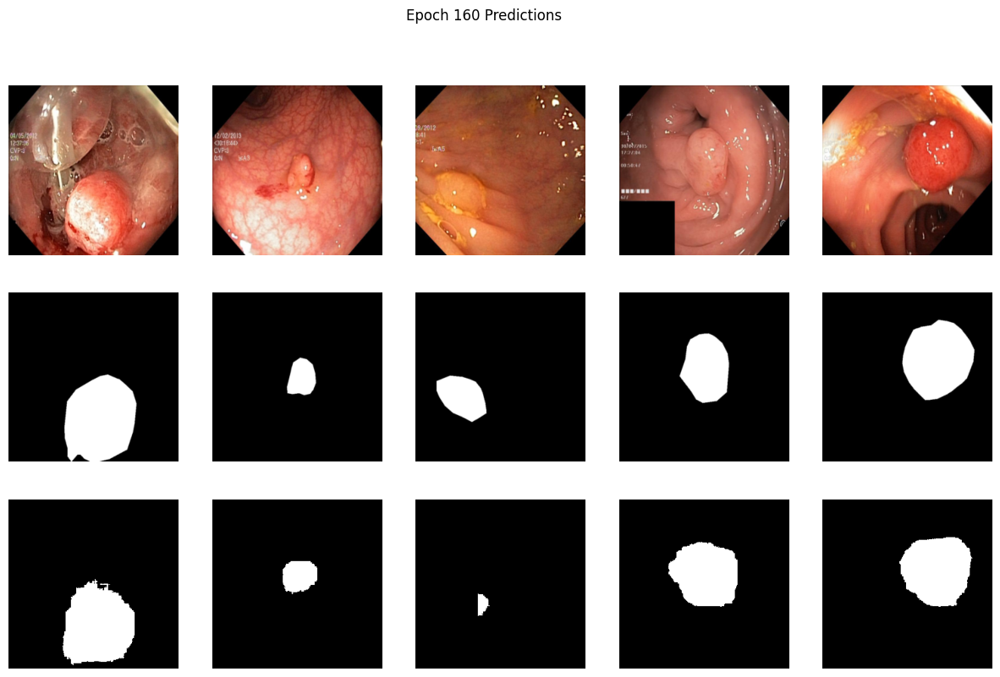

Epoch 161/250 | Train Loss: 0.5224 | Val Loss: 0.5117 | IoU: 0.5961
Epoch 162/250 | Train Loss: 0.4863 | Val Loss: 0.5675 | IoU: 0.5647
Epoch 163/250 | Train Loss: 0.5048 | Val Loss: 0.5729 | IoU: 0.5837
Epoch 164/250 | Train Loss: 0.5006 | Val Loss: 0.5435 | IoU: 0.5906
Epoch 165/250 | Train Loss: 0.4933 | Val Loss: 0.5625 | IoU: 0.5830


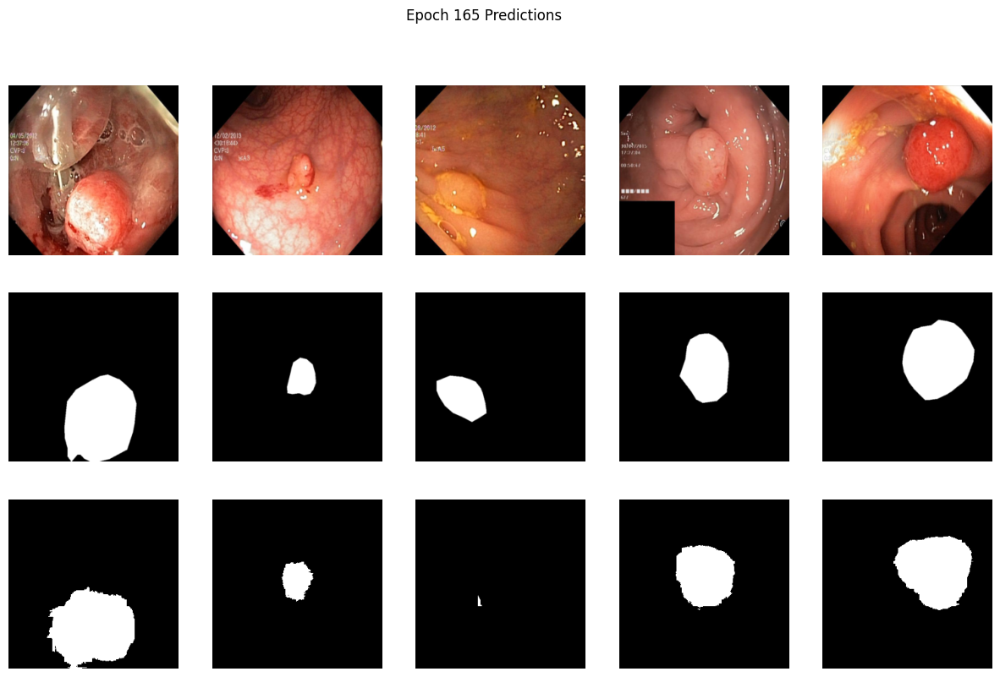

Epoch 166/250 | Train Loss: 0.5036 | Val Loss: 0.5384 | IoU: 0.5988
Epoch 167/250 | Train Loss: 0.4840 | Val Loss: 0.6126 | IoU: 0.5390
Epoch 168/250 | Train Loss: 0.4861 | Val Loss: 0.5433 | IoU: 0.5898
Epoch 169/250 | Train Loss: 0.4965 | Val Loss: 0.5129 | IoU: 0.6090
Epoch 170/250 | Train Loss: 0.4797 | Val Loss: 0.5033 | IoU: 0.6179


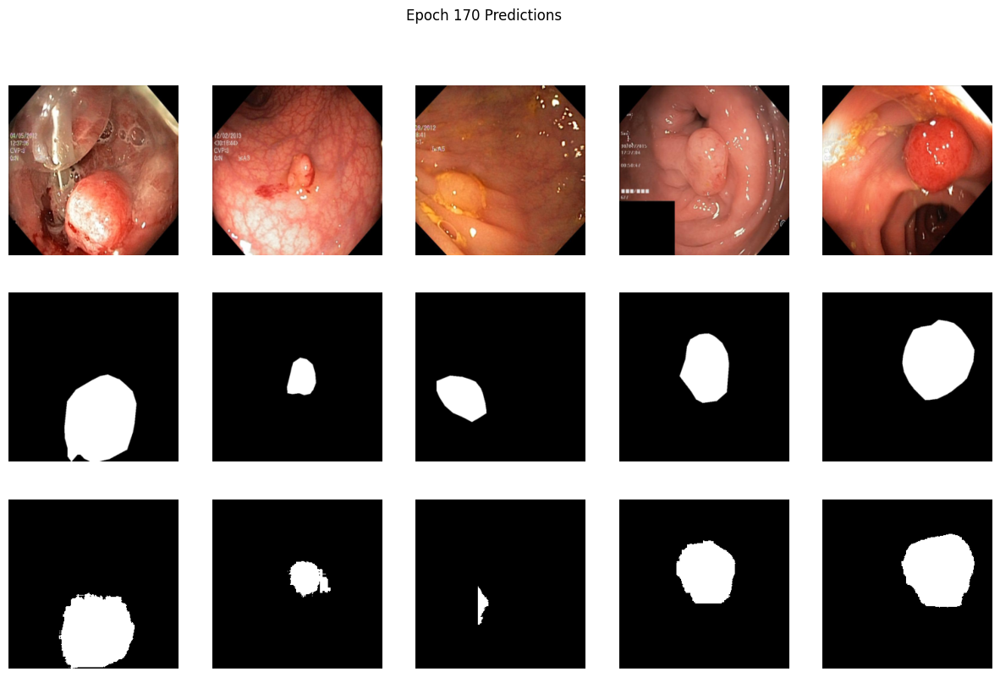

Epoch 171/250 | Train Loss: 0.4803 | Val Loss: 0.5459 | IoU: 0.5858
Epoch 172/250 | Train Loss: 0.4849 | Val Loss: 0.5419 | IoU: 0.5837
Epoch 173/250 | Train Loss: 0.4828 | Val Loss: 0.5811 | IoU: 0.5671
Epoch 174/250 | Train Loss: 0.4807 | Val Loss: 0.5346 | IoU: 0.5887
Epoch 175/250 | Train Loss: 0.4907 | Val Loss: 0.5288 | IoU: 0.6062


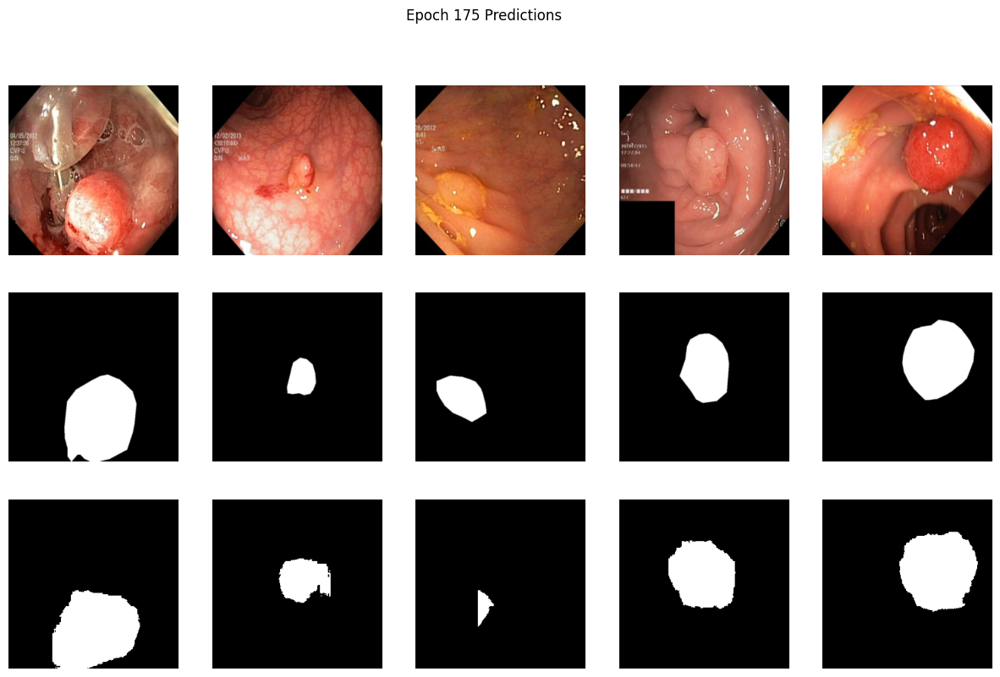

Epoch 176/250 | Train Loss: 0.4978 | Val Loss: 0.5133 | IoU: 0.6115
Epoch 177/250 | Train Loss: 0.4761 | Val Loss: 0.5824 | IoU: 0.5712
Epoch 178/250 | Train Loss: 0.4905 | Val Loss: 0.5401 | IoU: 0.5868
Epoch 179/250 | Train Loss: 0.4849 | Val Loss: 0.5176 | IoU: 0.6090
Epoch 180/250 | Train Loss: 0.4775 | Val Loss: 0.5188 | IoU: 0.6030


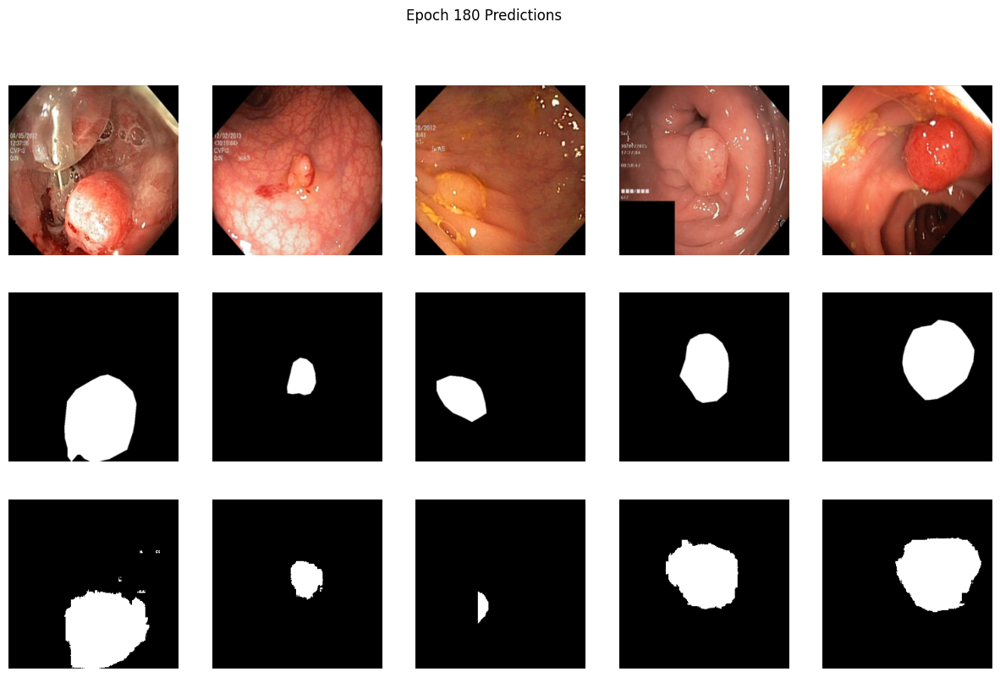

Epoch 181/250 | Train Loss: 0.4776 | Val Loss: 0.5425 | IoU: 0.5884
Epoch 182/250 | Train Loss: 0.4647 | Val Loss: 0.6691 | IoU: 0.5132
Epoch 183/250 | Train Loss: 0.4780 | Val Loss: 0.5468 | IoU: 0.5788
Epoch 184/250 | Train Loss: 0.4760 | Val Loss: 0.6342 | IoU: 0.5286
Epoch 185/250 | Train Loss: 0.4693 | Val Loss: 0.5484 | IoU: 0.5845


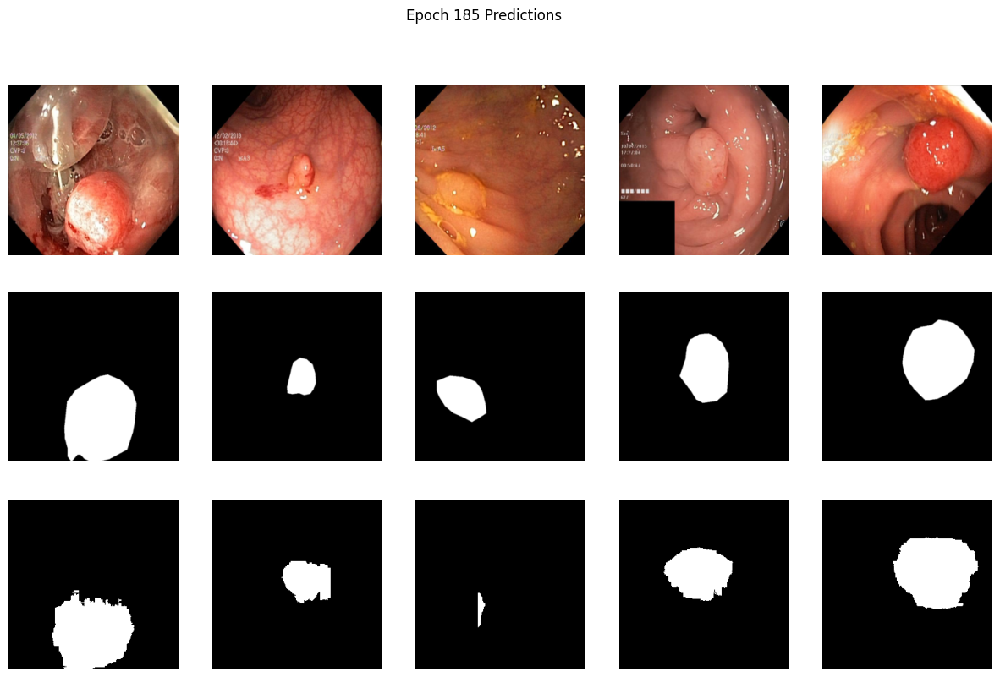

Epoch 186/250 | Train Loss: 0.4627 | Val Loss: 0.4734 | IoU: 0.6338
Saved best model at epoch 186
Epoch 187/250 | Train Loss: 0.4640 | Val Loss: 0.5173 | IoU: 0.6122
Epoch 188/250 | Train Loss: 0.4547 | Val Loss: 0.5479 | IoU: 0.5901
Epoch 189/250 | Train Loss: 0.4687 | Val Loss: 0.5222 | IoU: 0.6078
Epoch 190/250 | Train Loss: 0.4483 | Val Loss: 0.5693 | IoU: 0.5794


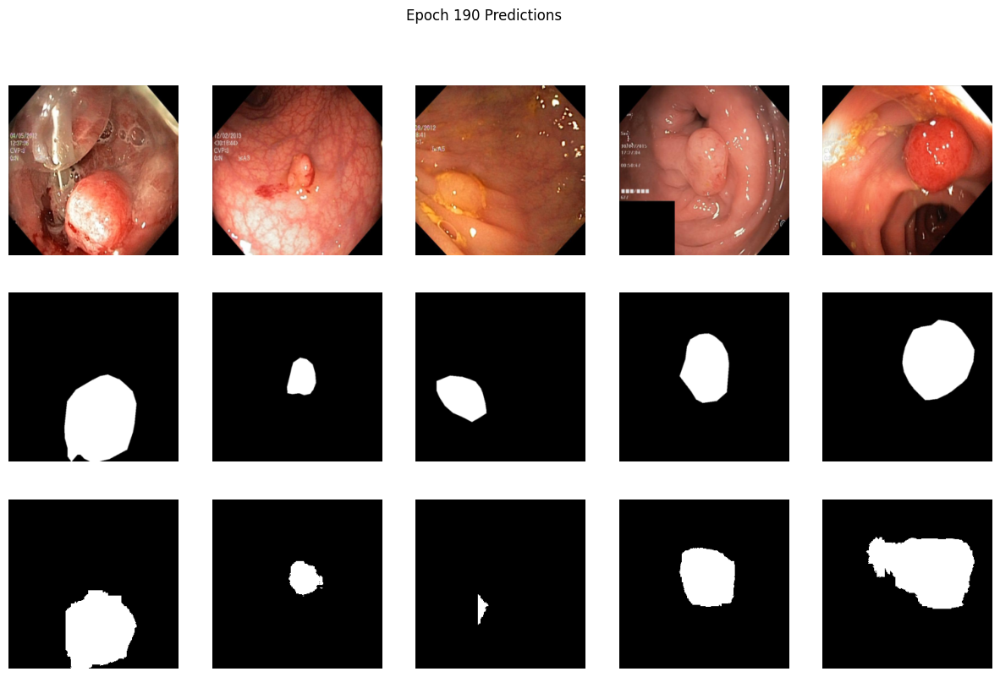

Epoch 191/250 | Train Loss: 0.4553 | Val Loss: 0.5652 | IoU: 0.5719
Epoch 192/250 | Train Loss: 0.4504 | Val Loss: 0.5455 | IoU: 0.5897
Epoch 193/250 | Train Loss: 0.4570 | Val Loss: 0.4935 | IoU: 0.6229
Epoch 194/250 | Train Loss: 0.4531 | Val Loss: 0.4919 | IoU: 0.6258
Epoch 195/250 | Train Loss: 0.4478 | Val Loss: 0.5111 | IoU: 0.6131


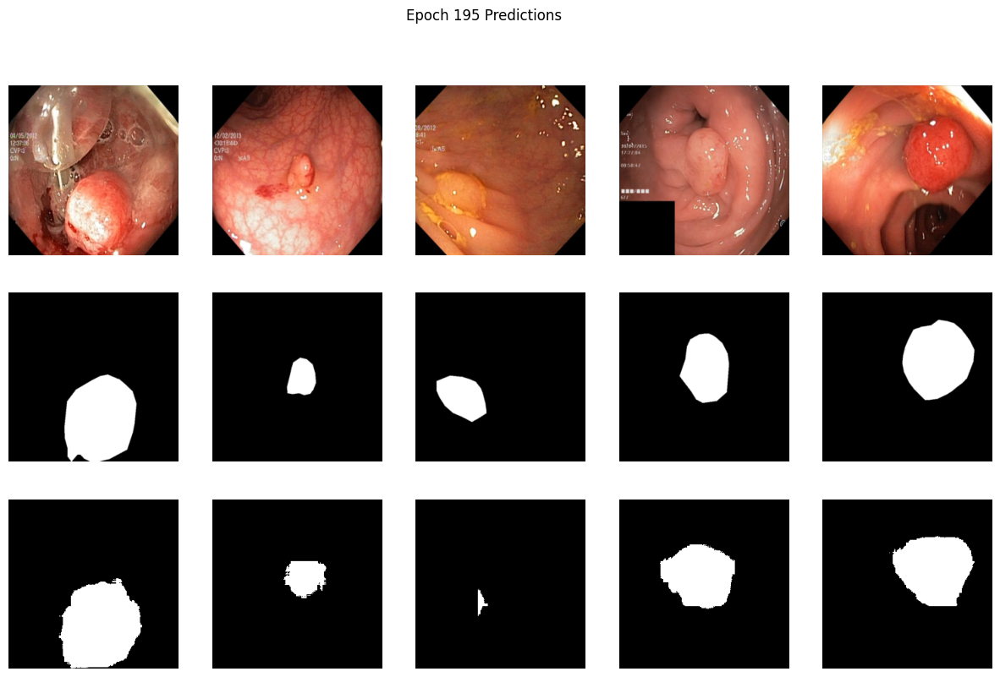

Epoch 196/250 | Train Loss: 0.4581 | Val Loss: 0.5185 | IoU: 0.6137
Epoch 197/250 | Train Loss: 0.4527 | Val Loss: 0.5625 | IoU: 0.5801
Epoch 198/250 | Train Loss: 0.4373 | Val Loss: 0.4933 | IoU: 0.6277
Epoch 199/250 | Train Loss: 0.4599 | Val Loss: 0.5749 | IoU: 0.5776
Epoch 200/250 | Train Loss: 0.4491 | Val Loss: 0.5580 | IoU: 0.5807


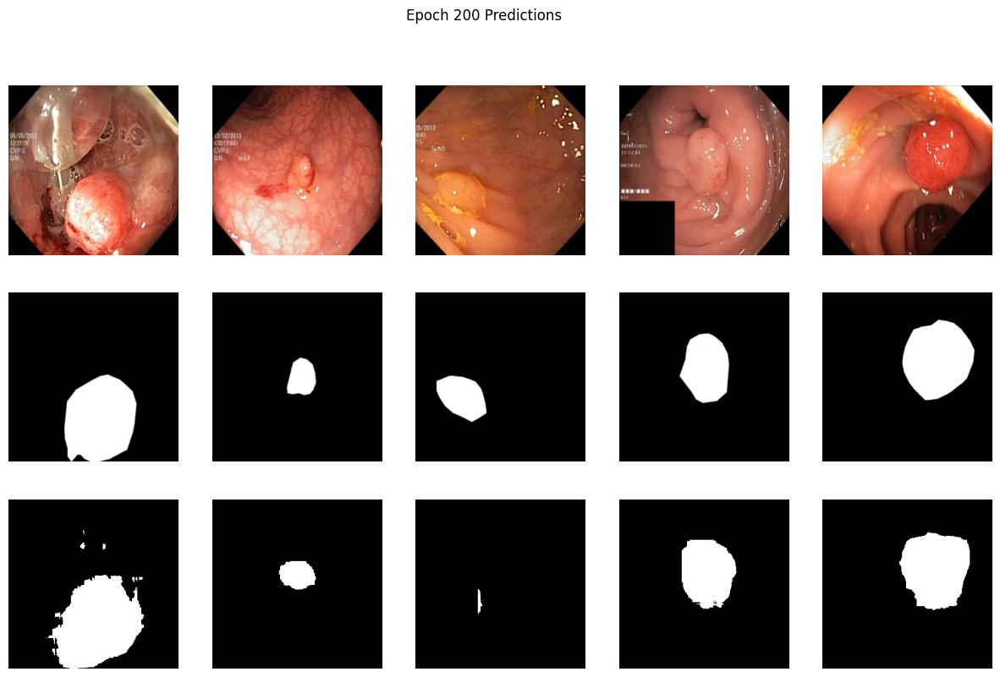

Epoch 201/250 | Train Loss: 0.4426 | Val Loss: 0.5325 | IoU: 0.5958
Epoch 202/250 | Train Loss: 0.4391 | Val Loss: 0.5257 | IoU: 0.6004
Epoch 203/250 | Train Loss: 0.4384 | Val Loss: 0.6886 | IoU: 0.4947
Epoch 204/250 | Train Loss: 0.4450 | Val Loss: 0.5860 | IoU: 0.5657
Epoch 205/250 | Train Loss: 0.4258 | Val Loss: 0.5864 | IoU: 0.5666


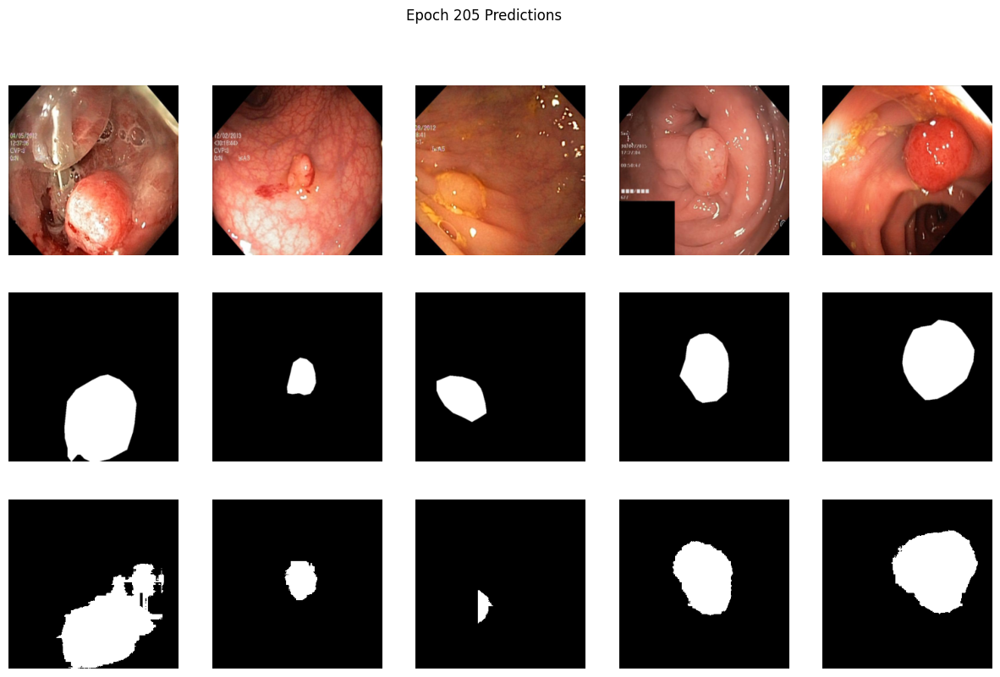

Epoch 206/250 | Train Loss: 0.4304 | Val Loss: 0.5544 | IoU: 0.5720
Epoch 207/250 | Train Loss: 0.4296 | Val Loss: 0.5499 | IoU: 0.5850
Epoch 208/250 | Train Loss: 0.4248 | Val Loss: 0.4988 | IoU: 0.6166
Epoch 209/250 | Train Loss: 0.4331 | Val Loss: 0.6076 | IoU: 0.5606
Epoch 210/250 | Train Loss: 0.4391 | Val Loss: 0.5562 | IoU: 0.5838


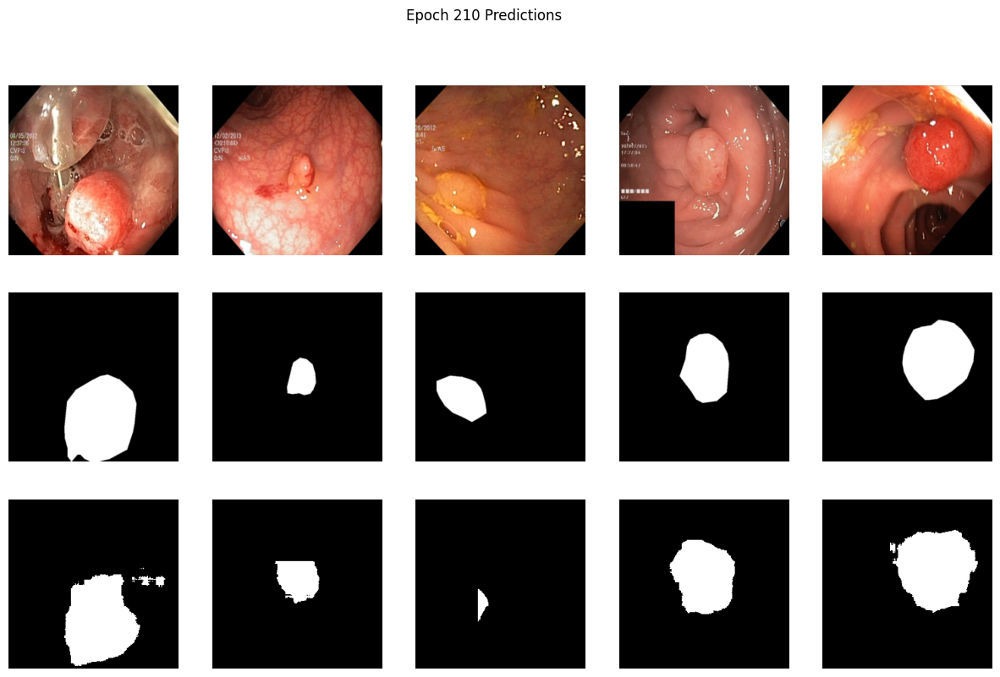

Epoch 211/250 | Train Loss: 0.4329 | Val Loss: 0.5817 | IoU: 0.5725
Epoch 212/250 | Train Loss: 0.4247 | Val Loss: 0.5429 | IoU: 0.6026
Epoch 213/250 | Train Loss: 0.4162 | Val Loss: 0.5544 | IoU: 0.5856
Epoch 214/250 | Train Loss: 0.4196 | Val Loss: 0.5631 | IoU: 0.5892
Epoch 215/250 | Train Loss: 0.4226 | Val Loss: 0.5602 | IoU: 0.5760


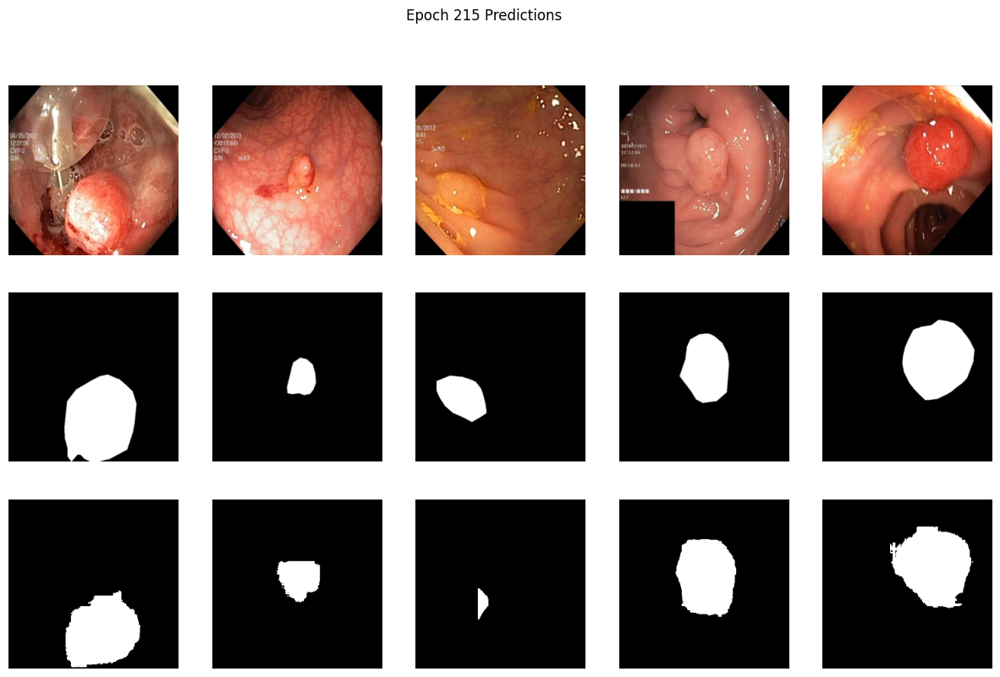

Epoch 216/250 | Train Loss: 0.4285 | Val Loss: 0.5805 | IoU: 0.5697
Epoch 217/250 | Train Loss: 0.4213 | Val Loss: 0.5479 | IoU: 0.5881
Epoch 218/250 | Train Loss: 0.4312 | Val Loss: 0.5336 | IoU: 0.5978
Epoch 219/250 | Train Loss: 0.4120 | Val Loss: 0.5706 | IoU: 0.5764
Epoch 220/250 | Train Loss: 0.4100 | Val Loss: 0.5181 | IoU: 0.5989


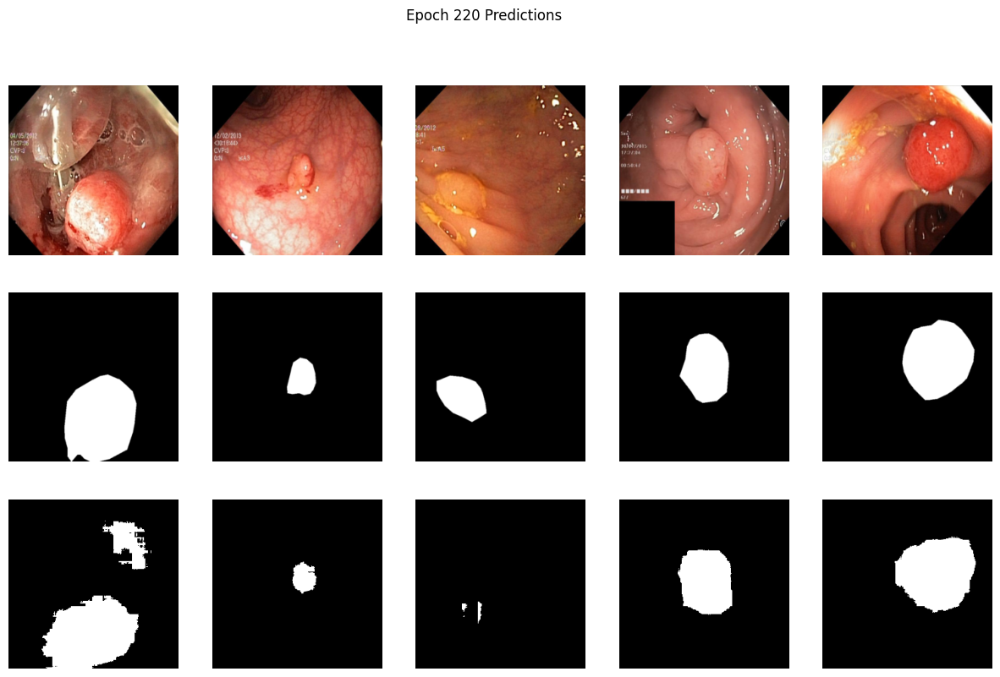

Epoch 221/250 | Train Loss: 0.4209 | Val Loss: 0.5495 | IoU: 0.5878
Epoch 222/250 | Train Loss: 0.4139 | Val Loss: 0.5691 | IoU: 0.5718
Epoch 223/250 | Train Loss: 0.4188 | Val Loss: 0.5566 | IoU: 0.5816
Epoch 224/250 | Train Loss: 0.4184 | Val Loss: 0.5584 | IoU: 0.5832
Epoch 225/250 | Train Loss: 0.4087 | Val Loss: 0.5836 | IoU: 0.5742


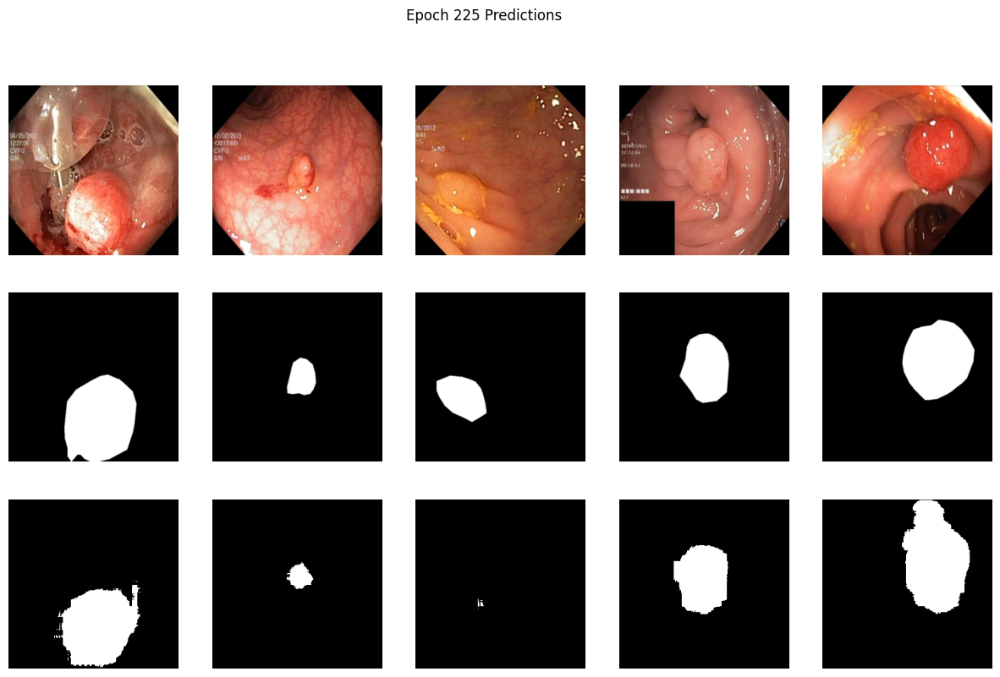

Epoch 226/250 | Train Loss: 0.4063 | Val Loss: 0.5248 | IoU: 0.6061
Epoch 227/250 | Train Loss: 0.4054 | Val Loss: 0.5506 | IoU: 0.5825
Epoch 228/250 | Train Loss: 0.3917 | Val Loss: 0.5516 | IoU: 0.5904
Epoch 229/250 | Train Loss: 0.3961 | Val Loss: 0.5037 | IoU: 0.6111
Epoch 230/250 | Train Loss: 0.3951 | Val Loss: 0.5278 | IoU: 0.6024


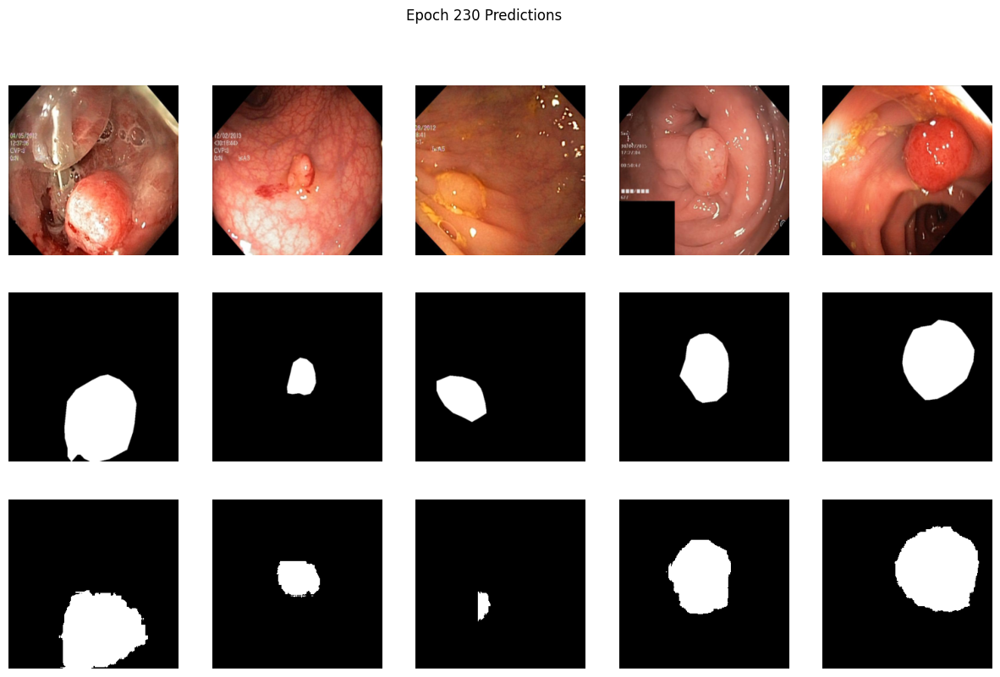

Epoch 231/250 | Train Loss: 0.4015 | Val Loss: 0.5704 | IoU: 0.5788
Epoch 232/250 | Train Loss: 0.3998 | Val Loss: 0.5788 | IoU: 0.5797
Epoch 233/250 | Train Loss: 0.3990 | Val Loss: 0.6229 | IoU: 0.5542
Epoch 234/250 | Train Loss: 0.3976 | Val Loss: 0.5681 | IoU: 0.5880
Epoch 235/250 | Train Loss: 0.3982 | Val Loss: 0.5544 | IoU: 0.5955


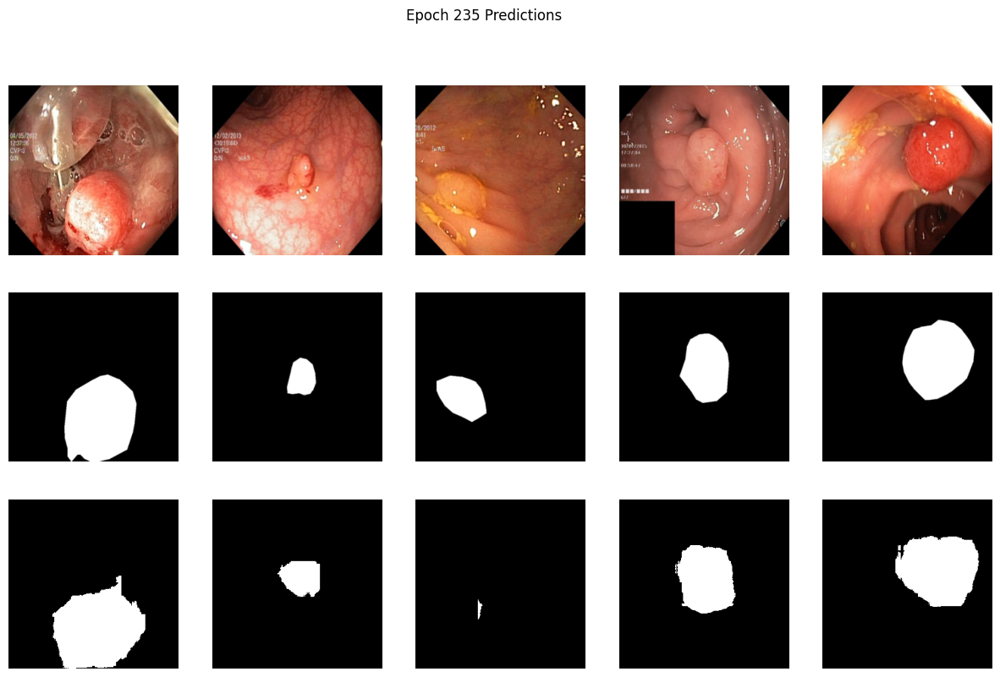

Epoch 236/250 | Train Loss: 0.3888 | Val Loss: 0.5369 | IoU: 0.5979
Epoch 237/250 | Train Loss: 0.4000 | Val Loss: 0.5368 | IoU: 0.6000
Epoch 238/250 | Train Loss: 0.3947 | Val Loss: 0.5553 | IoU: 0.5783
Epoch 239/250 | Train Loss: 0.3985 | Val Loss: 0.5706 | IoU: 0.5721
Epoch 240/250 | Train Loss: 0.4015 | Val Loss: 0.5447 | IoU: 0.5942


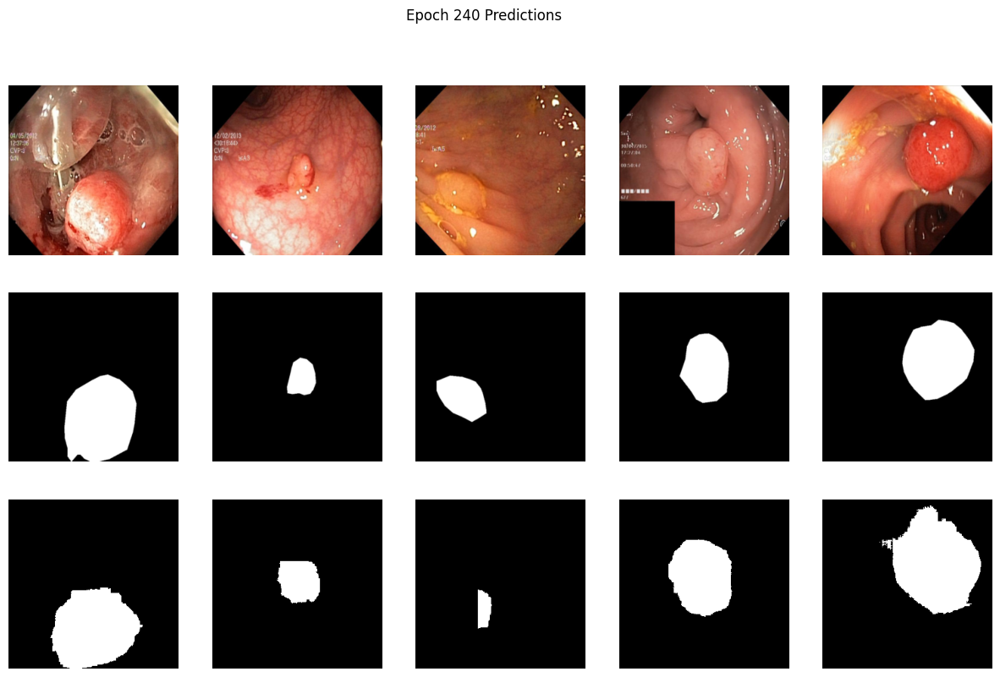

Epoch 241/250 | Train Loss: 0.3819 | Val Loss: 0.5467 | IoU: 0.5892
Epoch 242/250 | Train Loss: 0.3815 | Val Loss: 0.5319 | IoU: 0.6001
Epoch 243/250 | Train Loss: 0.3887 | Val Loss: 0.6048 | IoU: 0.5643
Epoch 244/250 | Train Loss: 0.3919 | Val Loss: 0.5390 | IoU: 0.6033
Epoch 245/250 | Train Loss: 0.3786 | Val Loss: 0.4923 | IoU: 0.6285


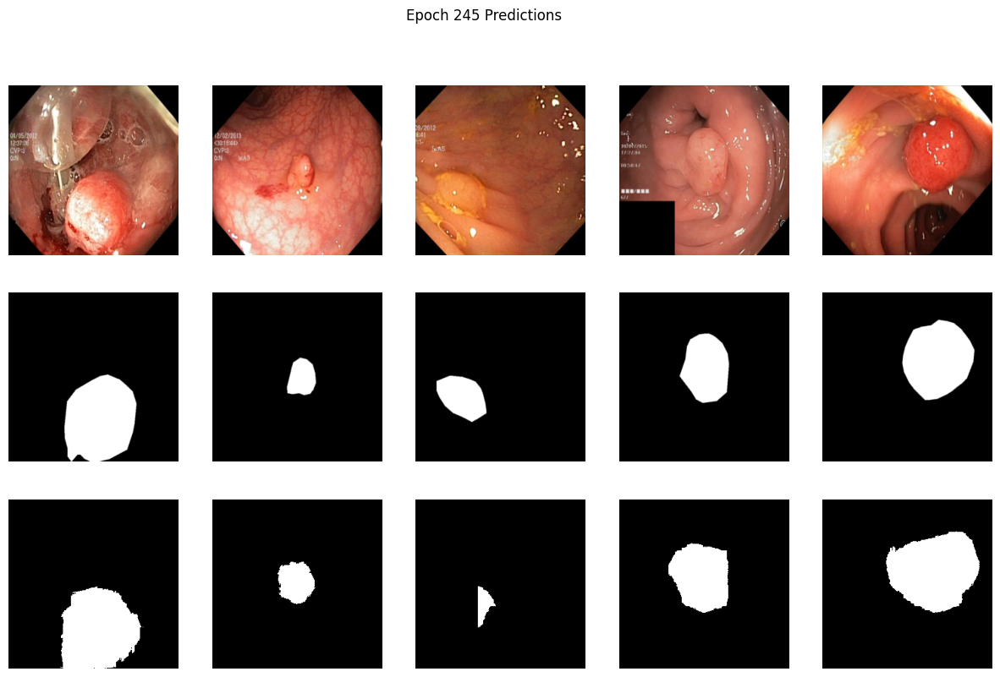

Epoch 246/250 | Train Loss: 0.3838 | Val Loss: 0.5952 | IoU: 0.5708
Epoch 247/250 | Train Loss: 0.3887 | Val Loss: 0.6177 | IoU: 0.5603
Epoch 248/250 | Train Loss: 0.3864 | Val Loss: 0.5596 | IoU: 0.5837
Epoch 249/250 | Train Loss: 0.3771 | Val Loss: 0.6198 | IoU: 0.5550
Epoch 250/250 | Train Loss: 0.3866 | Val Loss: 0.5526 | IoU: 0.5903


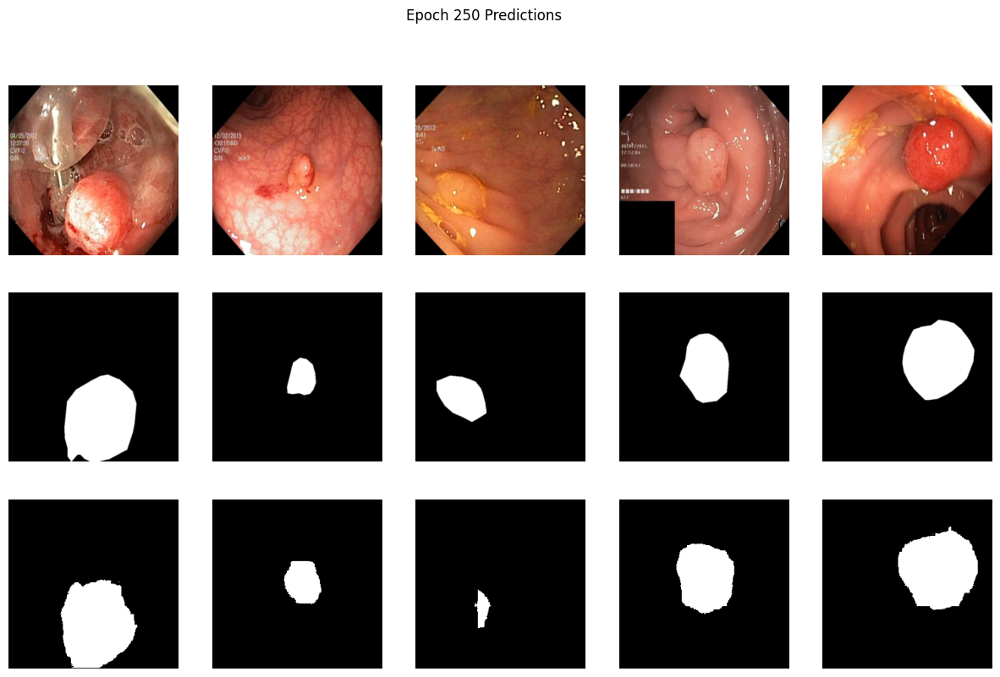

In [3]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import matplotlib.pyplot as plt
from sklearn.metrics import jaccard_score
from torchvision import transforms

# Device setup
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Dice Loss
def dice_loss(pred, target, smooth=1e-6):
    pred = torch.sigmoid(pred)
    intersection = (pred * target).sum()
    return 1 - (2. * intersection + smooth) / (pred.sum() + target.sum() + smooth)

bce_loss = nn.BCEWithLogitsLoss()

def combined_loss(pred, target):
    dice = dice_loss(pred, target)
    bce = bce_loss(pred, target)
    return bce + dice, bce, dice

# IoU calculation
def iou_score(pred, target):
    pred = (torch.sigmoid(pred) > 0.5).int().flatten()
    target = target.int().flatten()
    return (pred & target).sum().float() / ((pred | target).sum().float() + 1e-6)

# Ensure images are resized to 256x256
transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5], std=[0.5])  # Adjust mean/std for your dataset
])

# Define model
model = AttentionUNet(in_channels=3, out_channels=1).to(device)

optimizer = optim.Adam(model.parameters(), lr=1e-4)

checkpoint_path = "/kaggle/working/_att_unet_best_model.pth"


def train_or_eval(model, dataloader, criterion, optimizer=None, train=True):
    model.train() if train else model.eval()
    total_loss, total_bce, total_dice, total_iou = 0, 0, 0, 0

    with torch.set_grad_enabled(train):
        for images, masks in dataloader:
            images, masks = images.to(device), masks.to(device).float()
            outputs = model(images)
            loss, bce, dice = criterion(outputs, masks)
            if train:
                optimizer.zero_grad()
                loss.backward()
                optimizer.step()
            total_loss += loss.item()
            total_bce += bce.item()
            total_dice += dice.item()
            total_iou += iou_score(outputs.detach(), masks).item()

    return (total_loss / len(dataloader), total_bce / len(dataloader),
            total_dice / len(dataloader), total_iou / len(dataloader))

def visualize_predictions(loader, title):
    model.eval()
    with torch.no_grad():
        inputs, targets = next(iter(loader))
        inputs, targets = inputs.to(device), targets.to(device)
        outputs = (torch.sigmoid(model(inputs)) > 0.5).float()

        fig, axes = plt.subplots(3, 5, figsize=(15, 9))
        for i in range(5):
            img = inputs[i].cpu().permute(1, 2, 0) if inputs.shape[1] == 3 else inputs[i, 0].cpu()
            axes[0, i].imshow(img, cmap='gray' if inputs.shape[1] == 1 else None)
            axes[1, i].imshow(targets[i].cpu().squeeze(), cmap='gray')
            axes[2, i].imshow(outputs[i].cpu().squeeze(), cmap='gray')
            for ax in axes[:, i]: ax.axis("off")
        plt.suptitle(title)
        plt.show()

# Training loop
# Load best model if available
start_epoch = 0
try:
    checkpoint = torch.load(checkpoint_path, map_location=device)
    model.load_state_dict(checkpoint['model_state_dict'])
    best_val_loss = checkpoint.get('val_loss', float("inf"))
    start_epoch = checkpoint.get('epoch', 0)  # Retrieve last trained epoch
    print(f"Loaded best model with val_loss: {best_val_loss:.4f} | Resuming from epoch {start_epoch+1}")
except FileNotFoundError:
    print("No checkpoint found, starting training from scratch.")
    best_val_loss = float("inf")

# Training loop
num_epochs = 250  # Total epochs
for epoch in range(start_epoch, num_epochs):  # Resume from last epoch
    train_loss, train_bce, train_dice, train_iou = train_or_eval(model, train_loader, combined_loss, optimizer, train=True)
    val_loss, val_bce, val_dice, val_iou = train_or_eval(model, test_loader, combined_loss, train=False)

    current_epoch = epoch + 1  # Current epoch considering previous training
    print(f"Epoch {current_epoch}/{num_epochs} | Train Loss: {train_loss:.4f} | Val Loss: {val_loss:.4f} | IoU: {val_iou:.4f}")

    if val_loss < best_val_loss:
        best_val_loss = val_loss
        torch.save({'model_state_dict': model.state_dict(), 'val_loss': val_loss, 'epoch': epoch}, checkpoint_path)
        print(f"Saved best model at epoch {current_epoch}")

    if (current_epoch) % 5 == 0:
        visualize_predictions(test_loader, title=f"Epoch {current_epoch} Predictions")
